In [1]:
import xarray as xr
import datetime
import sys
import pytz
import numpy as np
import matplotlib as mpl
from matplotlib import cm
import matplotlib.pyplot as plt
import pandas as pd
import time
import os
import pickle
import shapely
import networkx as nx  
import folium
from folium import plugins
import functools
import pyproj
from colormap import rgb2hex
from osgeo import gdal, ogr
from folium.plugins import TimestampedGeoJson
from opentnsim import core
from datetime import timedelta
import hatyan
from sklearn.decomposition import PCA
import scipy as sc
import scipy.signal
import bisect
import copy

In [2]:
@functools.lru_cache
def load_fis_network(url):
    """load the topological fairway information system network (vaarweginformatie.nl)"""

    # get the data from the url
    resp = requests.get(url)
    # convert to file object
    stream = io.StringIO(resp.text)
    
    # This will take a minute or two
    # Here we convert the network to a networkx object
    G = yaml.load(stream, Loader=yaml.Loader)

    # some brief info
    n_bytes = len(resp.content)
    msg = '''Loaded network from {url} file size {mb:.2f}MB. Network has {n_nodes} nodes and {n_edges} edges.'''
    summary = msg.format(url=url, mb=n_bytes / 1000**2, n_edges=len(G.edges), n_nodes=len(G.nodes))
    logger.info(summary)

    # The topological network contains information about the original geometry. 
    # Let's convert those into python shapely objects for easier use later
    for n in G.nodes:
        G.nodes[n]['geometry'] = shapely.geometry.Point(G.nodes[n]['X'], G.nodes[n]['Y'])
    for e in G.edges:
        edge = G.edges[e]
        edge['geometry'] = shapely.wkt.loads(edge['Wkt'])
        edge['length'] = edge_length(edge)    
    
    return G 

def edge_length(edge):
    """compute the great circle length of an edge
    The network version 0.1 contains the lat/lon distance in a length property. 
    But we need the "great circle" or projected distance. 
    Let's define a function to recompute it.
    """
    
    # get the geometry
    geom = edge['geometry']
    # get lon, lat
    lats, lons = np.array(geom).T
    # this requires pyproj 2.3.0
    distance = geod.line_length(lons, lats)

    return distance

def find_closest_edge(G, point):
    """find the closest edge on the graph from a given point"""
    
    distance = np.full((len(G.edges)), fill_value=np.nan)
    for ii, e in enumerate(G.edges):
        distance[ii] = point.distance(G.edges[e]['Info']['geometry'])
    name_edge = list(G.edges)[np.argmin(distance)]
    distance_edge = np.min(distance)
    
    return name_edge, distance_edge

def find_closest_node(G, point):
    """find the closest node on the graph from a given point"""
    
    distance = np.full((len(G.nodes)), fill_value=np.nan)
    for ii, n in enumerate(G.nodes):
        distance[ii] = point.distance(G.nodes[n]['geometry'])
    name_node = list(G.nodes)[np.argmin(distance)]
    distance_node = np.min(distance)
    
    return name_node, distance_node

def color_sampler(value,colormap,norm):
    color = colormap(norm(value))
    return rgb2hex(int(color[0]*255),int(color[1]*255),int(color[2]*255))

In [3]:
url = 'https://zenodo.org/record/4578289/files/network_digital_twin_v0.2.yaml'

# create a cached version to speed up loading (remove cached file if a better yaml file is available)
fname = "fis_cache\\{}.pkl".format('FIS')

if os.path.exists(fname):
    print('I am loading cached network')
    with open(fname, 'rb') as pkl_file:
        FG = pickle.load(pkl_file)
        pkl_file.close()

else:
    print('I am getting new network')
    FG = load_fis_network(url)

    os.makedirs(os.path.dirname(fname), exist_ok=True)
    with open(fname, 'wb') as pkl_file:
        pickle.dump(FG, pkl_file)
        pkl_file.close()

I am loading cached network


In [4]:
file_path1 = os.path.join(os.getcwd(),'02_hydrodynamic_data','Polygon FIS Network PoR.kml')
file_path1 = os.path.join(os.getcwd(),'02_hydrodynamic_data','Polygon FIS Network PoR.json')

srcDS = gdal.OpenEx(file_path1)
gdal.VectorTranslate('Polygon FIS Network PoR.json', srcDS, format='GeoJSON')

polygon = shapely.geometry.Polygon([[4.047046106288641, 51.994530949601149, 0.0 ], [ 4.041820334307678, 51.985794447379547, 0.0 ], [ 4.032638009410599, 51.987359301430168, 0.0 ], [ 4.026085029365865, 51.986529814588927, 0.0 ], [ 4.023082985071111, 51.985502004661448, 0.0 ], [ 4.00823290473104, 51.988174970713708, 0.0 ], [ 3.998553814899393, 51.987323088053131, 0.0 ], [ 3.987086024543889, 51.983489630873457, 0.0 ], [ 3.980367408521741, 51.978923864007278, 0.0 ], [ 3.972858821044363, 51.972254400764548, 0.0 ], [ 3.964975414140348, 51.962100235646908, 0.0 ], [ 3.965767078274776, 51.958192943818972, 0.0 ], [ 3.9714783688349, 51.946631494630573, 0.0 ], [ 3.983298387670107, 51.927838319363971, 0.0 ], [ 3.987657598176972, 51.919192330532567, 0.0 ], [ 3.996387468717351, 51.916655170259958, 0.0 ], [ 4.001520162387755, 51.917060309257401, 0.0 ], [ 4.012557173047844, 51.920229693122977, 0.0 ], [ 4.048001660981074, 51.929016004063037, 0.0 ], [ 4.074660383723856, 51.934902766449348, 0.0 ], [ 4.093265372959262, 51.934893193914142, 0.0 ], [ 4.109255167927888, 51.93372388247014, 0.0 ], [ 4.126734837924461, 51.932516710383318, 0.0 ], [ 4.139980260895813, 51.931607190411903, 0.0 ], [ 4.147852124552989, 51.929605717664337, 0.0 ], [ 4.154871093926527, 51.92643205114458, 0.0 ], [ 4.164068865894088, 51.922235472642527, 0.0 ], [ 4.168497166059588, 51.919961894548123, 0.0 ], [ 4.173765785457206, 51.917888566713337, 0.0 ], [ 4.177471853896762, 51.916075611730989, 0.0 ], [ 4.19143525340012, 51.910078064370317, 0.0 ], [ 4.202511571167557, 51.904617634287582, 0.0 ], [ 4.212615864448434, 51.899592844692521, 0.0 ], [ 4.219017538516361, 51.895881651452001, 0.0 ], [ 4.223832400198837, 51.890530353414427, 0.0 ], [ 4.226873738466466, 51.887326711590937, 0.0 ], [ 4.228951660169189, 51.883411780650917, 0.0 ], [ 4.230693981376918, 51.879498998972053, 0.0 ], [ 4.23245567320008, 51.876804618361149, 0.0 ], [ 4.235713735314597, 51.874394644882933, 0.0 ], [ 4.240860704028409, 51.871936856471507, 0.0 ], [ 4.246713039932697, 51.869742419056138, 0.0 ], [ 4.256500276768536, 51.866468683159347, 0.0 ], [ 4.263681165876234, 51.864338061762467, 0.0 ], [ 4.270856008579235, 51.864165082808469, 0.0 ], [ 4.277892120705451, 51.86439728390355, 0.0 ], [ 4.286849974208358, 51.8645882221536, 0.0 ], [ 4.292522161762808, 51.864277013800361, 0.0 ], [ 4.299811679854974, 51.864101583593218, 0.0 ], [ 4.311303788739909, 51.864116069612663, 0.0 ], [ 4.329734623050854, 51.864276123508454, 0.0 ], [ 4.331499517754396, 51.864024053521959, 0.0 ], [ 4.333688920564924, 51.862880975070347, 0.0 ], [ 4.336262605418339, 51.859939034098609, 0.0 ], [ 4.34137585560622, 51.854360268676722, 0.0 ], [ 4.351538393640837, 51.847648283939193, 0.0 ], [ 4.362976373927347, 51.843831785091027, 0.0 ], [ 4.370084445558557, 51.841582728647857, 0.0 ], [ 4.380089933091171, 51.840617401653859, 0.0 ], [ 4.391081067036453, 51.839898516477582, 0.0 ], [ 4.399478875843261, 51.840163345822617, 0.0 ], [ 4.408773767123155, 51.841091522022268, 0.0 ], [ 4.416943663050734, 51.840074266710687, 0.0 ], [ 4.423210503951149, 51.838579340029192, 0.0 ], [ 4.427503697165283, 51.836513860483983, 0.0 ], [ 4.425576770167599, 51.834095807664362, 0.0 ], [ 4.429533318178938, 51.832633476567118, 0.0 ], [ 4.430960005176178, 51.833741029897993, 0.0 ], [ 4.434887510360975, 51.833765267256481, 0.0 ], [ 4.43690383938546, 51.83312364379659, 0.0 ], [ 4.444075259200149, 51.831057027288622, 0.0 ], [ 4.455433085635423, 51.829280289923247, 0.0 ], [ 4.46771578321205, 51.829690776121659, 0.0 ], [ 4.478878685926199, 51.830795076878637, 0.0 ], [ 4.488164498900886, 51.832451656061437, 0.0 ], [ 4.497474736200315, 51.832277533876983, 0.0 ], [ 4.504006118328753, 51.831563991137351, 0.0 ], [ 4.512048063063212, 51.829681547431278, 0.0 ], [ 4.52023617846478, 51.827734951843553, 0.0 ], [ 4.527396173112097, 51.827099310549393, 0.0 ], [ 4.533930342872021, 51.828087046218492, 0.0 ], [ 4.54119648874229, 51.829604882537978, 0.0 ], [ 4.546648500960357, 51.829305402579081, 0.0 ], [ 4.552248982461713, 51.827676804936857, 0.0 ], [ 4.554747912727908, 51.824662856298893, 0.0 ], [ 4.557658515089615, 51.818037740135757, 0.0 ], [ 4.562338329955282, 51.812146737080482, 0.0 ], [ 4.567790268643788, 51.808872879868893, 0.0 ], [ 4.575257216434827, 51.80678730057928, 0.0 ], [ 4.58251573514719, 51.805521253772739, 0.0 ], [ 4.590037627731165, 51.805171699165371, 0.0 ], [ 4.597774284387466, 51.804055987532443, 0.0 ], [ 4.604313450900881, 51.802297307784549, 0.0 ], [ 4.613475866941057, 51.800235897440317, 0.0 ], [ 4.617341098435928, 51.798124369718323, 0.0 ], [ 4.618362378336296, 51.796181342994132, 0.0 ], [ 4.621252023873148, 51.790276378816401, 0.0 ], [ 4.62409979956345, 51.782635434416783, 0.0 ], [ 4.623941953031045, 51.77630929086952, 0.0 ], [ 4.623064754206448, 51.763389962802563, 0.0 ], [ 4.624433481891639, 51.757517082463593, 0.0 ], [ 4.627814435262847, 51.75075427110778, 0.0 ], [ 4.627879472881458, 51.743955186361127, 0.0 ], [ 4.626354092832785, 51.736179071181077, 0.0 ], [ 4.623290219595805, 51.726941768179799, 0.0 ], [ 4.619409050652274, 51.721750961942199, 0.0 ], [ 4.616120550381302, 51.716182645862659, 0.0 ], [ 4.609566079180749, 51.709477107202552, 0.0 ], [ 4.605050592100282, 51.705466495857721, 0.0 ], [ 4.600730591394282, 51.702608721228763, 0.0 ], [ 4.593484968687383, 51.700694538430596, 0.0 ], [ 4.578029217511245, 51.698311310158317, 0.0 ], [ 4.566507458151197, 51.695868601503108, 0.0 ], [ 4.556646021680121, 51.694506492441057, 0.0 ], [ 4.544885547002719, 51.692528879578767, 0.0 ], [ 4.546338018922178, 51.687750048814117, 0.0 ], [ 4.567420841100791, 51.69114986797571, 0.0 ], [ 4.568815806261195, 51.688246505711163, 0.0 ], [ 4.574402919128991, 51.673642115923442, 0.0 ], [ 4.582440212968, 51.675045873653353, 0.0 ], [ 4.603759922942611, 51.67909424032014, 0.0 ], [ 4.609000212678733, 51.682787850019203, 0.0 ], [ 4.61322770400086, 51.687589032555543, 0.0 ], [ 4.616346068304478, 51.688505385639402, 0.0 ], [ 4.618177114470288, 51.689083597445311, 0.0 ], [ 4.611503886862787, 51.700539553693048, 0.0 ], [ 4.618547235224733, 51.704758620916408, 0.0 ], [ 4.621188579458506, 51.70912483940171, 0.0 ], [ 4.625278654281832, 51.71853614447808, 0.0 ], [ 4.62895981688983, 51.726591934181187, 0.0 ], [ 4.631015273970891, 51.731345868647637, 0.0 ], [ 4.632270606035429, 51.73633287458577, 0.0 ], [ 4.634070893980669, 51.74383147071385, 0.0 ], [ 4.633874592083471, 51.752192752634713, 0.0 ], [ 4.630948981882912, 51.759574802772647, 0.0 ], [ 4.629120910421564, 51.765486142676011, 0.0 ], [ 4.629532349597874, 51.770814439938789, 0.0 ], [ 4.630894904718586, 51.77947979515762, 0.0 ], [ 4.630205119517427, 51.784593728340461, 0.0 ], [ 4.644155121160485, 51.784738066131723, 0.0 ], [ 4.64675789658717, 51.785521955122, 0.0 ], [ 4.648523080480585, 51.787655536083861, 0.0 ], [ 4.648380883747016, 51.791059131401887, 0.0 ], [ 4.648653816976214, 51.797693391205897, 0.0 ], [ 4.64901104999494, 51.806929426135078, 0.0 ], [ 4.649005053746082, 51.807578765213528, 0.0 ], [ 4.644316669744375, 51.808880483719882, 0.0 ], [ 4.641063113733887, 51.807100885321567, 0.0 ], [ 4.636305758391581, 51.805050274482483, 0.0 ], [ 4.631933508015191, 51.803574293533259, 0.0 ], [ 4.626968120311867, 51.802438675475052, 0.0 ], [ 4.620497311172034, 51.802272999154503, 0.0 ], [ 4.615951679076103, 51.803311401541073, 0.0 ], [ 4.606272307986039, 51.806284851480697, 0.0 ], [ 4.596159971591947, 51.808126778121583, 0.0 ], [ 4.586158031535925, 51.808844780132617, 0.0 ], [ 4.579447886128047, 51.810058867002901, 0.0 ], [ 4.573060189604023, 51.812295490473929, 0.0 ], [ 4.566012519971096, 51.815434547502242, 0.0 ], [ 4.563773566221736, 51.818687634757516, 0.0 ], [ 4.563201599006845, 51.821957279842117, 0.0 ], [ 4.562968089313304, 51.824543181240337, 0.0 ], [ 4.558540613429947, 51.82964006740454, 0.0 ], [ 4.552433393126092, 51.832316314254932, 0.0 ], [ 4.545014088655261, 51.834290234059893, 0.0 ], [ 4.537158070334188, 51.833393779336141, 0.0 ], [ 4.530038207031499, 51.832102384556208, 0.0 ], [ 4.526108059542169, 51.831813208714102, 0.0 ], [ 4.521717619046028, 51.832590425155978, 0.0 ], [ 4.516732521897168, 51.833960245101871, 0.0 ], [ 4.514236527391809, 51.834496902354807, 0.0 ], [ 4.509974165494395, 51.83553112330867, 0.0 ], [ 4.501820011750192, 51.837106988151767, 0.0 ], [ 4.495840125581275, 51.837258622122228, 0.0 ], [ 4.486864901019976, 51.837137748460393, 0.0 ], [ 4.478183135596048, 51.83618389210767, 0.0 ], [ 4.472439264345458, 51.835228495563783, 0.0 ], [ 4.461775016379061, 51.833908716258769, 0.0 ], [ 4.453922237117189, 51.833744056940958, 0.0 ], [ 4.445880993540623, 51.83521472745835, 0.0 ], [ 4.433867160146994, 51.838656519273393, 0.0 ], [ 4.42470273645797, 51.841440135427547, 0.0 ], [ 4.42153152386223, 51.842243381585881, 0.0 ], [ 4.412288631756962, 51.844837057595839, 0.0 ], [ 4.404628276058093, 51.845147332925059, 0.0 ], [ 4.394141940257916, 51.844056513242528, 0.0 ], [ 4.385970084449699, 51.84384058231597, 0.0 ], [ 4.38009310776012, 51.844281463545563, 0.0 ], [ 4.36989301637785, 51.845910018863457, 0.0 ], [ 4.360483758821787, 51.848313888858193, 0.0 ], [ 4.354349626537848, 51.851008172324264, 0.0 ], [ 4.347909504952052, 51.855404628831913, 0.0 ], [ 4.342408539850937, 51.86054970135617, 0.0 ], [ 4.337899232746361, 51.865294765331257, 0.0 ], [ 4.335433216951134, 51.869785988478348, 0.0 ], [ 4.333552618008243, 51.873809653870651, 0.0 ], [ 4.348428925913814, 51.875946272051308, 0.0 ], [ 4.369163929813908, 51.878317553006468, 0.0 ], [ 4.38839016518595, 51.87815521453539, 0.0 ], [ 4.401107220355129, 51.877058298559803, 0.0 ], [ 4.426040664379522, 51.873026806667077, 0.0 ], [ 4.437079597260853, 51.871386012190683, 0.0 ], [ 4.448943520990141, 51.871564030747429, 0.0 ], [ 4.454263046403941, 51.871932213390657, 0.0 ], [ 4.454612554075805, 51.876499560242912, 0.0 ], [ 4.461854063353627, 51.892501464714812, 0.0 ], [ 4.466785298039618, 51.894872117693943, 0.0 ], [ 4.472093734132137, 51.894358029456889, 0.0 ], [ 4.475597745139166, 51.893088291767661, 0.0 ], [ 4.495575011014354, 51.897022475135103, 0.0 ], [ 4.497482873128506, 51.904708775055248, 0.0 ], [ 4.483610341771596, 51.910345930077462, 0.0 ], [ 4.482760758326021, 51.909513132342788, 0.0 ], [ 4.481354888673367, 51.907659452044847, 0.0 ], [ 4.480171615622785, 51.906587418413928, 0.0 ], [ 4.478656007166948, 51.905614334220239, 0.0 ], [ 4.47420728963661, 51.903986716234108, 0.0 ], [ 4.468091888502901, 51.902252150225287, 0.0 ], [ 4.465003985162294, 51.907646878763657, 0.0 ], [ 4.462309529254382, 51.906989997256652, 0.0 ], [ 4.458607445683542, 51.904702185072551, 0.0 ], [ 4.450510265256744, 51.902876957622773, 0.0 ], [ 4.444600706587229, 51.903309513507153, 0.0 ], [ 4.440641527550353, 51.905721770934349, 0.0 ], [ 4.43802672176208, 51.907881366164169, 0.0 ], [ 4.432905776054799, 51.910555872287738, 0.0 ], [ 4.426112874198747, 51.912467834061907, 0.0 ], [ 4.422383819883729, 51.913168929583513, 0.0 ], [ 4.411878223585475, 51.913540129396402, 0.0 ], [ 4.409521680173807, 51.911005537418113, 0.0 ], [ 4.409980373031104, 51.907863380341098, 0.0 ], [ 4.410238903774557, 51.905760620712883, 0.0 ], [ 4.40792824029834, 51.905695231506868, 0.0 ], [ 4.408236980724604, 51.901856095046021, 0.0 ], [ 4.402375508953853, 51.900192780344398, 0.0 ], [ 4.398972492127681, 51.899588847278451, 0.0 ], [ 4.398510798786443, 51.904247434360137, 0.0 ], [ 4.397094621487874, 51.90646667642546, 0.0 ], [ 4.385614359534216, 51.907989085010612, 0.0 ], [ 4.378087964881123, 51.909686675033377, 0.0 ], [ 4.374128281325, 51.908694908241579, 0.0 ], [ 4.367852653269681, 51.908306138351691, 0.0 ], [ 4.363397244884773, 51.909430864627993, 0.0 ], [ 4.356519147274849, 51.906592072056007, 0.0 ], [ 4.349296405899398, 51.904046653826121, 0.0 ], [ 4.348244134194987, 51.903702932010567, 0.0 ], [ 4.349406111299523, 51.899790994706308, 0.0 ], [ 4.344160954128946, 51.898618840978919, 0.0 ], [ 4.335081568788706, 51.896868371347999, 0.0 ], [ 4.326200276202865, 51.896412521739443, 0.0 ], [ 4.32457076936686, 51.900817957716093, 0.0 ], [ 4.319738626071643, 51.900546337822448, 0.0 ], [ 4.307247475566158, 51.900885572136751, 0.0 ], [ 4.276804688291795, 51.907441861806603, 0.0 ], [ 4.260087950487823, 51.913551219808411, 0.0 ], [ 4.25162487299372, 51.91669563964313, 0.0 ], [ 4.248376913383156, 51.91449410685788, 0.0 ], [ 4.245717112143339, 51.915364621818703, 0.0 ], [ 4.243630834376155, 51.916354360761702, 0.0 ], [ 4.235899751919456, 51.921703697987638, 0.0 ], [ 4.228306802315593, 51.928844045846439, 0.0 ], [ 4.215768636252541, 51.935587344495282, 0.0 ], [ 4.199751571089035, 51.941361577730078, 0.0 ], [ 4.187845586291519, 51.946336059832333, 0.0 ], [ 4.174792346056993, 51.952774770268881, 0.0 ], [ 4.160900691414067, 51.960268474450572, 0.0 ], [ 4.143905642848278, 51.96883626854671, 0.0 ], [ 4.128162638085904, 51.9746278367287, 0.0 ], [ 4.125530375394987, 51.975262010141122, 0.0 ], [ 4.120117786508599, 51.977185994794318, 0.0 ], [ 4.116406216069988, 51.978663950477113, 0.0 ], [ 4.10945387129291, 51.981203138086038, 0.0 ], [ 4.093364376007981, 51.984944583465733, 0.0 ], [ 4.047046106288641, 51.994530949601149, 0.0 ] ] )


In [5]:
nodes = []
edges = []

node_names = []

for edge in FG.edges(data = True):
    node_1 = FG.nodes[edge[0]]
    node_2 = FG.nodes[edge[1]]
    
    if node_1["geometry"].within(polygon) or node_2["geometry"].within(polygon):
        nodes.append(node_1)
        nodes.append(node_2)
        node_names.append(edge[0])
        node_names.append(edge[1])
        edges.append(edge)

In [6]:
FG = nx.DiGraph() #FG_new

for i in range(len(nodes)):
    node = nodes[i]
    node_name = node_names[i]
    FG.add_node(node_name, name = str((node['X'], node['Y'])), Position = (node['X'], node['Y']), geometry = node["geometry"])

for edge in edges:
    FG.add_edge(edge[0], edge[1], Info = edge[2]) 

for i in range(3):
    FG.remove_edge(find_closest_edge(FG,shapely.geometry.Point([4.488648,51.908018]))[0][0],find_closest_edge(FG,shapely.geometry.Point([4.488648,51.908018]))[0][1])

nodes_to_be_removed = ['8860852','B4705_A','B4705_B','B45486_B','L4199_A','B27780191_A','B27780191_B','8867741','B23888_B','B23888_A','L6951_B','L6951_A','L43910_B','L43910_A','B16957_B','B57921_A','L57066_B','L57066_A']
for n in nodes_to_be_removed:
    FG.remove_node(n)

#Node 1
node_name = '8866969B'
node["geometry"] = shapely.geometry.Point([FG.nodes['8866969']['geometry'].x,
                                           FG.nodes['8866969']['geometry'].y])
node['X'] = node["geometry"].x
node['Y'] = node["geometry"].y
FG.add_node(node_name, name = str((node['X'], node['Y'])), Position = (node['X'], node['Y']), geometry = node["geometry"])

Info = FG.edges[('8862214', '8864217')]['Info']
Info['StartJunctionId'] = '8866969'
Info['EndJunctionId'] = '8866969B'
Info['Length'] = 0
Info['length'] = pyproj.Geod(ellps="WGS84").inv(FG.nodes['8866969']['geometry'].x,
                                                FG.nodes['8866969']['geometry'].y,
                                                FG.nodes['8866969B']['geometry'].x,
                                                FG.nodes['8866969B']['geometry'].y,)[2]
Info['Wkt'] = ('LINESTRING (' + str(FG.nodes['8866969']['geometry'].x) + ', ' +
                                str(FG.nodes['8866969']['geometry'].y) + ', ' +
                                str(FG.nodes['8866969B']['geometry'].x) + ', ' +
                                str(FG.nodes['8866969B']['geometry'].y)) + ')'
node_1 = shapely.geometry.Point(FG.nodes['8866969']['geometry'].x,FG.nodes['8866969']['geometry'].y)
node_2 = shapely.geometry.Point(FG.nodes['8866969B']['geometry'].x,FG.nodes['8866969B']['geometry'].y)
Info['geometry'] = shapely.geometry.LineString([node_1, node_2])

FG.add_edge('8866969', '8866969B',Info=Info)


#Node 2
node_name = '8866969A'
node["geometry"] = shapely.geometry.Point([FG.nodes['8866969']['geometry'].x,
                                           FG.nodes['8866969']['geometry'].y])
node['X'] = node["geometry"].x
node['Y'] = node["geometry"].y
FG.add_node(node_name, name = str((node['X'], node['Y'])), Position = (node['X'], node['Y']), geometry = node["geometry"])

Info = FG.edges[('8862214', '8864217')]['Info']
Info['StartJunctionId'] = '8866969B'
Info['EndJunctionId'] = '8866969A'
Info['Length'] = 0
Info['length'] = pyproj.Geod(ellps="WGS84").inv(FG.nodes['8866969B']['geometry'].x,
                                                FG.nodes['8866969B']['geometry'].y,
                                                FG.nodes['8866969A']['geometry'].x,
                                                FG.nodes['8866969A']['geometry'].y,)[2]
Info['Wkt'] = ('LINESTRING (' + str(FG.nodes['8866969B']['geometry'].x) + ', ' +
                                str(FG.nodes['8866969B']['geometry'].y) + ', ' +
                                str(FG.nodes['8866969A']['geometry'].x) + ', ' +
                                str(FG.nodes['8866969A']['geometry'].y)) + ')'
node_1 = shapely.geometry.Point(FG.nodes['8866969B']['geometry'].x,FG.nodes['8866969B']['geometry'].y)
node_2 = shapely.geometry.Point(FG.nodes['8866969A']['geometry'].x,FG.nodes['8866969A']['geometry'].y)
Info['geometry'] = shapely.geometry.LineString([node_1, node_2])

FG.add_edge('8866969B', '8866969A',Info=Info)

#Node 3
node_name = '8866969C'
node["geometry"] = shapely.geometry.Point([FG.nodes['8866969']['geometry'].x,
                                           FG.nodes['8866969']['geometry'].y])
node['X'] = node["geometry"].x
node['Y'] = node["geometry"].y
FG.add_node(node_name, name = str((node['X'], node['Y'])), Position = (node['X'], node['Y']), geometry = node["geometry"])

Info = FG.edges[('8862214', '8864217')]['Info']
Info['StartJunctionId'] = '8866969B'
Info['EndJunctionId'] = '8866969C'
Info['Length'] = 0
Info['length'] = pyproj.Geod(ellps="WGS84").inv(FG.nodes['8866969B']['geometry'].x,
                                                FG.nodes['8866969B']['geometry'].y,
                                                FG.nodes['8866969C']['geometry'].x,
                                                FG.nodes['8866969C']['geometry'].y,)[2]
Info['Wkt'] = ('LINESTRING (' + str(FG.nodes['8866969B']['geometry'].x) + ', ' +
                                str(FG.nodes['8866969B']['geometry'].y) + ', ' +
                                str(FG.nodes['8866969C']['geometry'].x) + ', ' +
                                str(FG.nodes['8866969C']['geometry'].y)) + ')'
node_1 = shapely.geometry.Point(FG.nodes['8866969B']['geometry'].x,FG.nodes['8866969B']['geometry'].y)
node_2 = shapely.geometry.Point(FG.nodes['8866969C']['geometry'].x,FG.nodes['8866969C']['geometry'].y)
Info['geometry'] = shapely.geometry.LineString([node_1, node_2])

FG.add_edge('8866969B', '8866969C',Info=Info)

#Recreate simplified Rozenburgse Sluis
Info = FG.edges[('B7951_A','B7951_B')]['Info']
Info['StartJunctionId'] = 'B57361_A'
Info['EndJunctionId'] = 'B7951_B'
Info['length'] = pyproj.Geod(ellps='WGS84').inv(FG.nodes['B7951_A']['geometry'].x,
                                                FG.nodes['B7951_A']['geometry'].y,
                                                FG.nodes['B57361_A']['geometry'].x,
                                                FG.nodes['B57361_A']['geometry'].y)[2]
Info['length'] = 0
Info['Wkt'] = ('LINESTRING (' + str(FG.nodes['8866969B']['geometry'].x) + ', ' +
                                str(FG.nodes['8866969B']['geometry'].y) + ', ' +
                                str(FG.nodes['8866969C']['geometry'].x) + ', ' +
                                str(FG.nodes['8866969C']['geometry'].y)) + ')'
node_1 = shapely.geometry.Point(FG.nodes['B7951_A']['geometry'].x,FG.nodes['B7951_A']['geometry'].y)
node_2 = shapely.geometry.Point(FG.nodes['B57361_A']['geometry'].x,FG.nodes['B57361_A']['geometry'].y)
Info['geometry'] = shapely.geometry.LineString([node_1, node_2])

FG.add_edge('B57361_A', 'B7951_B', Info=Info)

In [7]:
FG = FG.to_undirected() 
FG = FG.to_directed()

In [8]:
station_data_0 = xr.open_dataset(r'C:\Users\floorbakker\surfdrive\Documents\PhD SALTISolutions\03_Models\OSR2019\OSR data\nc\SDS-NG03_01jan-31mrt_2019SDS-NG03_01jan-31mrt_2019-selected-stations.nc')
station_data_1 = xr.open_dataset(r'C:\Users\floorbakker\surfdrive\Documents\PhD SALTISolutions\03_Models\OSR2019\OSR data\nc\SDS-NG03_01apr-30jun_2019SDS-NG03_01apr-30jun_2019-selected-stations.nc')
station_data_2 = xr.open_dataset(r'C:\Users\floorbakker\surfdrive\Documents\PhD SALTISolutions\03_Models\OSR2019\OSR data\nc\SDS-NG03_01jul-30sep_2019SDS-NG03_01jul-30sep_2019-selected-stations.nc')
station_data_3 = xr.open_dataset(r'C:\Users\floorbakker\surfdrive\Documents\PhD SALTISolutions\03_Models\OSR2019\OSR data\nc\SDS-NG03_01okt-31dec_2019SDS-NG03_01okt-31dec_2019-selected-stations.nc')
moerdijk_data = pd.read_csv(r'C:\Users\floorbakker\surfdrive\Documents\PhD SALTISolutions\03_Models\OSR2019\Waterinfo data\Moerdijk_2019.csv',delimiter=';')
time_replacement_data = list(moerdijk_data['WAARNEMINGDATUM'][1415:1415+52561]+' '+moerdijk_data['WAARNEMINGTIJD (MET/CET)'][1415:1415+52561])
time_replacement_data = [np.datetime64(datetime.datetime.strptime(datetimestring, '%d-%m-%Y %H:%M:%S')) for datetimestring in time_replacement_data]
water_level_replacement_data = xr.DataArray(data = [moerdijk_data['NUMERIEKEWAARDE'][1415:1415+52561]/100], dims=["STATION","TIME"], coords={'TIME': ('TIME',time_replacement_data), 'STATION': ('STATION',['8868071'])})
easting_current_velocity_replacement_data = xr.DataArray(data = [[np.zeros(len(moerdijk_data['NUMERIEKEWAARDE'][1415:1415+52561]/100)) for layer in range(10)]], dims=["STATION","LAYER","TIME"], coords={'TIME': time_replacement_data, 'STATION': ['8868071']})
northing_current_velocity_replacement_data = xr.DataArray(data = [[np.zeros(len(moerdijk_data['NUMERIEKEWAARDE'][1415:1415+52561]/100)) for layer in range(10)]], dims=["STATION","LAYER","TIME"], coords={'TIME': time_replacement_data, 'STATION': ['8868071']})
layers_replacement_data = xr.DataArray(data = [[np.zeros(len(moerdijk_data['NUMERIEKEWAARDE'][1415:1415+52561]/100)) for layer in range(10)]], dims=["STATION","LAYER","TIME"], coords={'TIME': time_replacement_data, 'STATION': ['8868071']})

replacement_data = xr.Dataset(data_vars={'Water level': water_level_replacement_data,
                                         'Easting current velocity': easting_current_velocity_replacement_data,
                                         'Northing current velocity': northing_current_velocity_replacement_data,
                                         'Layers': layers_replacement_data})

C:\Users\floorbakker\Anaconda3\envs\gdal\lib\site-packages\xarray\conventions.py:516: SerializationWarning:

variable 'NAMPOL' has multiple fill values {'', b''}, decoding all values to NaN.

C:\Users\floorbakker\Anaconda3\envs\gdal\lib\site-packages\xarray\conventions.py:516: SerializationWarning:

variable 'NAMPOL' has multiple fill values {'', b''}, decoding all values to NaN.

C:\Users\floorbakker\Anaconda3\envs\gdal\lib\site-packages\xarray\conventions.py:516: SerializationWarning:

variable 'NAMPOL' has multiple fill values {'', b''}, decoding all values to NaN.

C:\Users\floorbakker\Anaconda3\envs\gdal\lib\site-packages\xarray\conventions.py:516: SerializationWarning:

variable 'NAMPOL' has multiple fill values {'', b''}, decoding all values to NaN.

C:\Users\floorbakker\Anaconda3\envs\gdal\lib\site-packages\IPython\core\interactiveshell.py:3169: DtypeWarning:

Columns (46,47,49) have mixed types.Specify dtype option on import or set low_memory=False.



In [9]:
data = [station_data_0,station_data_1,station_data_2,station_data_3]
for data_set in data:
    data_set['ZCURU'] = data_set['ZCURU'].rename({'STATIONCUR':'STATION'})
    data_set['ZCURU'] = data_set['ZCURU'].assign_coords({'NAMPOL': ('STATION', data_set['ZWL']['NAMPOL'].values)})
    data_set['ZCURV'] = data_set['ZCURV'].rename({'STATIONCUR':'STATION'})
    data_set['ZCURV'] = data_set['ZCURV'].assign_coords({'NAMPOL': ('STATION', data_set['ZWL']['NAMPOL'].values)})
    
replacement_data = [replacement_data]

dataformat_data = {'Water level': 'ZWL', 
                   'Easting current velocity': 'ZCURU', 
                   'Northing current velocity': 'ZCURV', 
                   'Layers': 'ZKPOLC'}

dimformat_data = {'TIME': 'TIME',
                  'STATION': 'STATION', 
                  'STATIONCUR': 'STATION', 
                  'LAYER': 'LAYER', 
                  'CONSTIT': 'CONSTIT'}

varformat_data = {'TIME':'Times',
                  'NAMPOL':'Stations'}

dataformat_replacement_data = {'Water level': 'Water level', 
                               'Easting current velocity':'Easting current velocity',
                               'Northing current velocity':'Northing current velocity',
                               'Layers':'Layers'}

dimformat_replacement_data = {'TIME': 'TIME', 
                              'STATION': 'STATION', 
                              'LAYER': 'LAYER'}

varformat_replacement_data = {'TIME':'Times',
                              'STATION':'Stations'}

station_names = list(station_data_0['NAMPOL'].values)
station_names.extend(['8868071'])
list_of_station_nodes_names = [name.decode("utf-8").replace(" ", "") if type(name) == bytes else name for name in station_names]
list_of_additional_stations = ['Eemhaven','Heysehaven','Koningshaven','Maashaven','Waalhaven','Wiltonhaven','Vulcaanhaven','Zevenmanshaven','Botlekhaven','2ePetroleumhaven','1ePetroleumhaven','Botlekbrug','Scheurkade','Centrale Geul']
list_of_node_names = []
selected_stations = []
for station_node_name in enumerate(list_of_station_nodes_names):
    node_found = False
    for node in FG.nodes:
        node_name = node.split('_')[0]
        if node_name in station_node_name[1]:
            list_of_node_names.append(node)
            node_found = True
            break
    if not node_found:
        for additional_station in list_of_additional_stations:
            if 'roleumhaven' in additional_station:
                station = additional_station.split('roleumhaven')[0]
            elif 'haven' in additional_station and 'brug' not in station_node_name[1]:
                station = additional_station.split('haven')[0] 
            elif ' ' in additional_station:
                station = additional_station.split(' ')[0]
            else:
                station = additional_station
            if station in station_node_name[1]:
                list_of_node_names.append(additional_station)
                node_found = True
                break
                
    if node_found:
        selected_stations.append(station_node_name[0])
    
station_interpreter = list_of_node_names
station_interpreter_indexes = [list(FG.nodes).index(station) if station in list(FG.nodes) else station for station in station_interpreter]
station_interpreter_indexes = [list(FG.nodes).index(station) if station in list(FG.nodes) else station for station in station_interpreter]
for index in enumerate(station_interpreter_indexes):
    if type(index[1]) == str:
        for additional_station in enumerate(list_of_additional_stations):
            if index[1] == additional_station[1]:
                station_interpreter_indexes[index[0]] = additional_station[0] + len(FG.nodes)
                break

freq_list = hatyan.full_const_list_withfreqs()
const_list = hatyan.get_const_list_hatyan('year')
selected_const = []
for const in const_list:
    index = list(freq_list.index).index(const)
    if freq_list['freq'][index] < (1/6):
        selected_const.append(const)
reduced_selected_const = selected_const[3:]

In [10]:
def astronomical_tide(signal_time, signal_values, time_zone, constituent_list = []):
    old_stdout = sys.stdout  # backup current stdout
    sys.stdout = open(os.devnull, "w")
    now = datetime.datetime.now(pytz.timezone(time_zone))
    tdif = now.replace(tzinfo=None)-datetime.datetime.now(pytz.timezone('Europe/London')).replace(tzinfo=None)
    signal_datetime = [(y- np.datetime64('1970-01-01T00:00:00'))/np.timedelta64(1, 's') for y in signal_time]
    signal_datetime
    duration = signal_datetime[-1] - signal_datetime[0]
    if constituent_list == []:
        periods = [[datetime.timedelta(minutes=25, hours=12), 'tidalcycle'],
                   [datetime.timedelta(days=1), 'day'],
                   [datetime.timedelta(days=14), 'springneap'],
                   [datetime.timedelta(days=31), 'month'],
                   [datetime.timedelta(days=365/2), 'halfyear'],
                   [datetime.timedelta(days=365), 'year']]
        indexes = [deltatime[0] >= datetime.timedelta(seconds=duration) for deltatime in periods]
        if True not in indexes: index = -1
        elif datetime.timedelta(seconds=duration) < datetime.timedelta(minutes=25, hours=12): return [signal_time, signal_values]
        else: index = indexes.index(True)
        const_list = hatyan.get_const_list_hatyan(periods[index][1])
    else:
        const_list = constituent_list
    ts_meas = pd.DataFrame({'values': signal_values}, index=signal_time)
    ts_meas = hatyan.crop_timeseries(ts=ts_meas, times_ext=signal_time);
    comp_frommeas, comp_allyears = hatyan.get_components_from_ts(ts=ts_meas, const_list=const_list,nodalfactors=True, return_allyears=True,fu_alltimes=True)
    ts_prediction = hatyan.prediction(comp=comp_frommeas, nodalfactors=True, xfac=True, fu_alltimes=True,times_ext=signal_time, timestep_min=10)
    sys.stdout = old_stdout  # reset old stdout
    return [[index.timestamp()-tdif.seconds for index in ts_prediction.index], [value for value in ts_prediction['values']]],tdif,comp_frommeas

def fixed2bearing(east_velocity, north_velocity, principal_direction):
    """ Function: calculates the velocity components in a reference frame parallel to the principal direction of the
                  velocity cluster. It returns the decomposed current velocity magnitudes in a reference frame relative
                  to the given principal direction.

        Input:
            - east_velocity: velocity in Eastern direction in m/s (float)
            - north_velocity: velocity in Northern direction in m/s (float)
            - principal_direction: principal direction in degrees in fixed reference frame North-East (float)
    """

    bearing_rad = np.radians(principal_direction)
    x_velocity = np.cos(bearing_rad) * east_velocity + np.sin(bearing_rad) * north_velocity
    #y_velocity = -1 * np.sin(bearing_rad) * east_velocity + np.cos(bearing_rad) * north_velocity

    return x_velocity

def fixed2principal_components(east_velocity_list, north_velocity_list):
    """ Function: calculates the principal components from a cluster of velocities. It returns principal direction
                  in degrees (float)

        Input:
            - east_velocity_list: list of velocities in Eastern direction (list)
            - north_velocity_list: list of velocities in Northern direction (list)
    """

    pca = PCA(n_components=2)
    X = np.column_stack((east_velocity_list, north_velocity_list))
    X_pca = pca.fit(X)
    y_pca = pca.components_[:, 1][0]
    x_pca = pca.components_[:, 0][0]
    theta = np.arctan2(y_pca, x_pca)
    alpha = np.degrees(theta)

    # Correction for positive alpha in coordinate system with positive x-direction upestuary
    if alpha >= 0:
        alpha = alpha - 180  # in degrees
    return alpha

def lag_finder(time_signal, signal1, signal2):
    max_signal1 = np.max([abs(y) for y in signal1])
    max_signal2 = np.max([abs(y) for y in signal2])
    signal1 = [y/max_signal1 for y in signal1]
    signal2 = [y/max_signal2 for y in signal2]
    norm_signal1 = signal1
    norm_signal2 = signal2
    nsamples = len(signal2)
    b, a = sc.signal.butter(2, 0.1)
    signal2 = sc.signal.filtfilt(b, a, signal2)
    # regularize datasets by subtracting mean and dividing by s.d.
    signal2 -= np.mean(signal2);
    signal2 /= np.std(signal2)
    signal1 -= np.mean(signal1);
    signal1 /= np.std(signal1)
    # Find cross-correlation
    xcorr = sc.signal.correlate(signal2, signal1)
    # delta time array to match xcorr
    dt = np.arange(1 - nsamples, nsamples)
    time_step = time_signal[1] - time_signal[0]
    delay = -1*(dt[xcorr.argmax()] * time_step)
    return delay

def observed_tidal_periods(dataset,times_horizontal_tidal_period,station):
    observed_times_horizontal_tidal_period = copy.deepcopy(times_horizontal_tidal_period)
    previous_index = 0
    for period in enumerate(observed_times_horizontal_tidal_period):
        if period[1][0] == len(dataset['Depth-averaged primary current velocity'].values[station]):
            continue
        if period[1][1] == 'Flood Start':
            if dataset['Depth-averaged primary current velocity'].values[station][period[1][0]] > 0:
                previ = np.argmin(dataset['Depth-averaged primary current velocity'].values[station][previous_index:(period[1][0]+1)])+previous_index
                if previ == (period[1][0]+1): previ -= 1
                new_index = np.argmin(abs(dataset['Depth-averaged primary current velocity'].values[station][previ:(period[1][0]+1)]))+previ
                maxie = np.min(dataset['Depth-averaged primary current velocity'].values[station][previous_index:(period[1][0]+1)])    
            elif dataset['Depth-averaged primary current velocity'].values[station][period[1][0]] < 0:
                if period[0] != len(observed_times_horizontal_tidal_period)-1:
                    next_index = np.argmax(dataset['Depth-averaged primary current velocity'].values[station][period[1][0]:observed_times_horizontal_tidal_period[period[0]+1][0]])+period[1][0]
                    if next_index == period[1][0]: next_index += 1
                    new_index = np.argmin(abs(dataset['Depth-averaged primary current velocity'].values[station][period[1][0]:next_index]))+period[1][0]
                    maxie = np.max(dataset['Depth-averaged primary current velocity'].values[station][period[1][0]:observed_times_horizontal_tidal_period[period[0]+1][0]])
        elif period[1][1] == 'Ebb Start':
            if dataset['Depth-averaged primary current velocity'].values[station][period[1][0]] > 0:
                if period[0] != len(observed_times_horizontal_tidal_period)-1:
                    next_index = np.argmin(dataset['Depth-averaged primary current velocity'].values[station][period[1][0]:observed_times_horizontal_tidal_period[period[0]+1][0]])+period[1][0]
                    if next_index == period[1][0]: next_index += 1
                    new_index = np.argmin(abs(dataset['Depth-averaged primary current velocity'].values[station][period[1][0]:next_index]))+period[1][0]
                    maxie = np.min(dataset['Depth-averaged primary current velocity'].values[station][period[1][0]:observed_times_horizontal_tidal_period[period[0]+1][0]])
            elif dataset['Depth-averaged primary current velocity'].values[station][period[1][0]] < 0: 
                previ = np.argmax(dataset['Depth-averaged primary current velocity'].values[station][previous_index:(period[1][0]+1)])+previous_index
                if previ == (period[1][0]+1): previ -= 1
                new_index = np.argmin(abs(dataset['Depth-averaged primary current velocity'].values[station][previ:(period[1][0]+1)]))+previ
                maxie = np.max(dataset['Depth-averaged primary current velocity'].values[station][previous_index:(period[1][0]+1)])  
        previous_index = new_index
        observed_times_horizontal_tidal_period[period[0]][0] = new_index

    return observed_times_horizontal_tidal_period

def tidal_periods(dataset,time_zone):
    times_vertical_tidal_periods = []
    times_horizontal_tidal_periods = []
    observed_times_horizontal_tidal_periods = []
    phase_lags = []
    time_step = (dataset['Times'].values[1]-dataset['Times'].values[0])/np.timedelta64(1,'s')
    timestamps = [(value-np.datetime64('1970-01-01T00:00:00'))/np.timedelta64(1, 's') for value in dataset['Times'].values]
    for station in range(len(dataset['STATION'].values)):
        astro_data_primary_current_velocity,_,comp_cur = astronomical_tide(dataset['Times'].values,dataset['Depth-averaged primary current velocity'][station].values,time_zone)
        astro_data_water_level_reduced,_,comp_wlev_red = astronomical_tide(dataset['Times'].values,dataset['Water level'][station].values,time_zone,reduced_selected_const)
        astro_data_primary_current_velocity_reduced,_,comp_cur_red = astronomical_tide(dataset['Times'].values,dataset['Depth-averaged primary current velocity'][station].values,time_zone,reduced_selected_const)   

        #Vertical tidal period
        roots = sc.interpolate.CubicSpline(timestamps,astro_data_water_level_reduced[1]).roots()
        roots = [root for root in roots if root>=timestamps[0] and root<=timestamps[-1]]
        times_vertical_tidal_period = []
        for root in enumerate(roots):
            if root[0] == 0:
                start_time = root[0]
                continue
            start_time_index = bisect.bisect_right(timestamps,roots[root[0]-1])-1
            end_time_index = bisect.bisect_right(timestamps,root[1])-1
            if start_time_index == end_time_index:
                continue
            wlev_diff_cross = astro_data_water_level_reduced[1][end_time_index+1]-astro_data_water_level_reduced[1][end_time_index-1]
            if wlev_diff_cross >= 0:
                min_wlev = np.min(astro_data_water_level_reduced[1][start_time_index:end_time_index])
                times_vertical_tidal_period.append([astro_data_water_level_reduced[1].index(min_wlev),'Rising Start'])
            elif wlev_diff_cross <= 0:
                max_wlev = np.max(astro_data_water_level_reduced[1][start_time_index:end_time_index])
                times_vertical_tidal_period.append([astro_data_water_level_reduced[1].index(max_wlev),'Falling Start'])

        if times_vertical_tidal_period[0][1] == 'Falling Start': 
            times_vertical_tidal_period.insert(0,[0,'Rising Start'])
        elif times_vertical_tidal_period[0][1] == 'Rising Start': 
            times_vertical_tidal_period.insert(0,[0,'Falling Start'])                           
        times_vertical_tidal_periods.append(times_vertical_tidal_period)

        #Phase shift
        phase_lag = lag_finder(timestamps,astro_data_water_level_reduced[1],astro_data_primary_current_velocity_reduced[1])
        mean_tidal_period = (timestamps[-1]-timestamps[0])/(len(times_vertical_tidal_period)/2)

        #Horizontal tidal period
        times_horizontal_tidal_period = []
        max_ampl_wlev = np.max(list(comp_wlev_red['A'][0:6]))+np.max(list(comp_wlev_red['A'][6:28]))+np.max(list(comp_wlev_red['A'][28:34]))+np.max(list(comp_wlev_red['A'][34:]))
        max_ampl_cur = np.max(list(comp_cur_red['A'][0:6]))+np.max(list(comp_cur_red['A'][6:28]))+np.max(list(comp_cur_red['A'][28:34]))+np.max(list(comp_cur_red['A'][34:]))
        if max_ampl_cur < 0.25:
            for period in times_vertical_tidal_period:
                if period[1] == 'Falling Start':
                    times_horizontal_tidal_period.append([period[0],'Ebb Start'])
                elif period[1] == 'Rising Start':
                    times_horizontal_tidal_period.append([period[0],'Flood Start'])
            phase_lag = 0.25*mean_tidal_period
            observed_times_horizontal_tidal_period = times_horizontal_tidal_period
        else:
            astro_data_primary_current_velocity_reduced[1] = [value-comp_cur_red['A'][0] for value in astro_data_primary_current_velocity_reduced[1]]
            for iteration in range(2*int(abs(phase_lag/mean_tidal_period))+1):
                if round(phase_lag/mean_tidal_period,1)*2*np.pi < -0.5*np.pi:
                    dataset['Depth-averaged primary current velocity'][station] = [-1*value for value in dataset['Depth-averaged primary current velocity'][station].values]
                    if phase_lag > 0: phase_lag = 0.5*mean_tidal_period-phase_lag
                    elif phase_lag < 0: phase_lag = 0.5*mean_tidal_period+phase_lag
                elif round(phase_lag/mean_tidal_period,1)*2*np.pi > 0.5*np.pi:
                    phase_lag = phase_lag-mean_tidal_period
                elif round(phase_lag/mean_tidal_period,1)*2*np.pi < -np.pi:
                    phase_lag = phase_lag+mean_tidal_period
                else:
                    break

            if phase_lag < 0:
                phase_lag = 0

            # Interpolation of the variation of the water level and calculation of the zero crossing times
            intp = sc.interpolate.CubicSpline(astro_data_primary_current_velocity_reduced[0], astro_data_primary_current_velocity_reduced[1])
            index_prev_root = 0
            for root in intp.roots():
                index_current_root = bisect.bisect_right(astro_data_primary_current_velocity_reduced[0], root)-1
                if index_current_root == -1: index_current_root = index_current_root + 1
                if astro_data_primary_current_velocity_reduced[0][index_current_root]-root <= time_step: index_current_root = index_current_root + 1
                if len(astro_data_primary_current_velocity_reduced[1][index_prev_root:index_current_root]) == 0:
                    continue
                if root >= timestamps[0] and root <= timestamps[-1] and np.max(astro_data_primary_current_velocity_reduced[1][index_prev_root:index_current_root]) > 0:
                    times_horizontal_tidal_period.append([index_current_root, 'Ebb Start'])
                    index_prev_root = index_current_root
                elif root >= timestamps[0] and root <= timestamps[-1] and np.min(astro_data_primary_current_velocity_reduced[1][index_prev_root:index_current_root]) < 0:
                    times_horizontal_tidal_period.append([index_current_root, 'Flood Start'])
                    index_prev_root = index_current_root
            observed_times_horizontal_tidal_period = observed_tidal_periods(dataset,times_horizontal_tidal_period,station)    

        phase_lags.append(np.degrees(phase_lag/mean_tidal_period*2*np.pi))
        times_horizontal_tidal_periods.append(times_horizontal_tidal_period)
        observed_times_horizontal_tidal_periods.append(observed_times_horizontal_tidal_period)
        plt.figure()
        plt.plot(dataset['Water level'][station].values)
        plt.plot(dataset['Depth-averaged primary current velocity'][station].values)
        plt.xlim([0,1000])
        plt.ylim([-1,2.5])
        plt.title(str(max_ampl_wlev)+' '+str(max_ampl_cur)+' '+str(round(phase_lag/mean_tidal_period,1)*2*np.pi))
        plt.show()
    return times_vertical_tidal_periods, times_horizontal_tidal_periods, phase_lags, observed_times_horizontal_tidal_periods

In [11]:
missing_indexes = []
for missing_index in range(0,len(FG.nodes)+len(list_of_additional_stations)):
    if missing_index not in station_interpreter_indexes:
        missing_indexes.append(missing_index)
        
missing_stations = []
for index in missing_indexes:
    if index < len(FG.nodes):
        missing_stations.append(list(FG.nodes)[index])
    else:
        missing_stations.append(list_of_additional_stations[index-len(FG.nodes)])

replacement_nodes = ['8868071','8868071','8868071','8868071','8868071','8868071','8868071','8868071','8860614','8860614','8868071','8868071',
 '8868071','8868071','8861067','8865385','8865385','8868071','8868071','8868071','8861414','8861674','8868071','8865575',
 '8863810','8868071','8868071','8868071','S38127_B','B5979609_A','8868071','8865972','S14716_A','8864482','8864653',
 '8864653','8868071','8868071','B17838816_B','B15339_A','B45863_B','8867023','8861414','8861414','8868071','B5729_A',
 '8860614','B42792_B','8867784','8868071','8868071','B33440_B','B49209_A','S38127_B','S38127_B','Berth30','8861414',
 '8866969','8866969','8866969','8866520','8861973']

replacement_nodes_use_current_velocity = [0,0,0,0,0,0,0,0,0,0,0,0,0,0,-1,0,0,0,0,0,-1,0,0,0,0,0,0,0,-1,-1,0,0,-1,0,0,0,0,0,-1,-1,-1,0,0,0,0,-1,0,-1,0,0,0,-1,-1,-1,-1,0,0,-1,-1,-1,-1,-1]

In [12]:
#Function lay-out:
def create_hydrodynamic_dataset(data,dataformat_data,dimformat_data,varformat_data,replacement_data,dataformat_replacement_data,dimformat_replacement_data,varformat_replacement_data,station_interpreter,selected_stations,missing_stations,replacement_nodes,replacement_nodes_use_current_velocity,measurements):
    #1) Load numerical data
    def read_numerical_dataArrays(data,dataformat,dimformat,varformat):
        dataset = {}
        water_level_data = []
        easting_current_velocity_data = []
        northing_current_velocity_data = []
        layer_data = []

        def rename_and_transpose_dataarray(data,dims,dimformat,name):
            data.name = name
            for dim in enumerate(data.dims):
                if dim[1] in data.dims:
                    data = data.rename({dim[1]: dimformat[data.dims[dim[0]]]}) 

            if data.dims != (dims):
                data = data.transpose(*dims)
    
            return data

        for data_set in range(len(data)):     
            dataset["dataset{0}".format(data_set)] = data[data_set].rename_vars(varformat)

        for data_set in enumerate(dataset):
            if data_set[0] == 0:
                if 'Water level' in dataformat:
                    water_level_data = dataset[data_set[1]][dataformat['Water level']]

                if 'Easting current velocity' in dataformat:
                    easting_current_velocity_data = dataset[data_set[1]][dataformat['Easting current velocity']]
                                                                   
                if 'Northing current velocity' in dataformat:
                    northing_current_velocity_data = dataset[data_set[1]][dataformat['Northing current velocity']]

                if 'Layers' in dataformat:
                    layer_data = dataset[data_set[1]][dataformat['Layers']]

            else:   
                if 'Water level' in dataformat:
                    water_level_data = xr.concat([water_level_data, dataset[data_set[1]][dataformat['Water level']][1:]], "TIME")
                    water_level_data['Stations'] = dataset[data_set[1]][dataformat['Water level']]['Stations']
                    
                if 'Easting current velocity' in dataformat:
                    easting_current_velocity_data = xr.concat([easting_current_velocity_data, dataset[data_set[1]][dataformat['Easting current velocity']][1:]], "TIME")
                    easting_current_velocity_data['Stations'] = dataset[data_set[1]][dataformat['Easting current velocity']]['Stations']
                    
                if 'Northing current velocity' in dataformat:
                    northing_current_velocity_data = xr.concat([northing_current_velocity_data, dataset[data_set[1]][dataformat['Northing current velocity']][1:]], "TIME")   
                    northing_current_velocity_data['Stations'] = dataset[data_set[1]][dataformat['Northing current velocity']]['Stations']
                    
                if 'Layers' in dataformat:
                    layer_data = xr.concat([layer_data, dataset[data_set[1]][dataformat['Layers']][1:]], "TIME")
                    layer_data['Stations'] = dataset[data_set[1]][dataformat['Layers']]['Stations']
                    
        if 'Water level' in dataformat:
            water_level_data = rename_and_transpose_dataarray(water_level_data,('STATION','TIME'),dimformat,'Water level')
            
        if 'Easting current velocity' in dataformat:
            easting_current_velocity_data = rename_and_transpose_dataarray(easting_current_velocity_data,('STATION','LAYER','TIME'),dimformat,'Easting current velocity')
            
        if 'Northing current velocity' in dataformat:                                                            
            northing_current_velocity_data = rename_and_transpose_dataarray(northing_current_velocity_data,('STATION','LAYER','TIME'),dimformat,'Northing current velocity')

        if 'Layers' in dataformat:
            layer_data = rename_and_transpose_dataarray(layer_data,('STATION','LAYER','TIME'),dimformat,'Layers')

        return water_level_data,easting_current_velocity_data,northing_current_velocity_data,layer_data
        
    #2) Load replacement data
    def read_measurement_dataArrays(replacement_data,dataformat_replacement_data,dimformat_replacement_data,varformat_replacement_data):
        replacement_data = read_numerical_dataArrays(replacement_data,dataformat_replacement_data,dimformat_replacement_data,varformat_replacement_data)
        return replacement_data

    #3) Combine datasets
    def combine_dataArrays(data,replacement_data):
        combined_data = []
        for data_set in data:
            combined_data_set = data_set
            for replacement_data_set in replacement_data:
                if data_set.name == replacement_data_set.name:
                    combined_data_set = xr.concat([data_set,replacement_data_set],'STATION')
            combined_data.append(combined_data_set)
        return combined_data 
    
    #4) Clean-up dataset
    def clean_up_dataArrays(combined_data,station_interpreter,selected_stations):
        cleant_combined_data = []
        for data_set in combined_data:
            data_set.transpose()
            data_set = xr.concat([data_set[index] for index in selected_stations],'STATION')
            data_set['Stations'].values = station_interpreter
            cleant_combined_data.append(data_set)
        return cleant_combined_data
    
    #5) Create main dataset
    def create_main_dataset(data):      
        dataset = xr.Dataset()
        for data_set in data:
            dataset[data_set.name] = data_set
        return dataset
    
    #6) Derive main information based on simple mathematical operations
    def derive_main_information(dataset):
        layer_bounds = []
        layer_bounds.append(dataset['Water level'][0][0].values)
        for layer_depth_center in dataset['Layers'][0].transpose('TIME','LAYER')[0].values:
            layer_bounds.append(layer_depth_center-(layer_bounds[-1]-layer_depth_center))

        layer_heights = []
        for bounds in enumerate(layer_bounds):
            if bounds[0] == 0:
                continue
            layer_heights.append(layer_bounds[bounds[0]-1]-bounds[1])

        relative_layer_heights = []
        for height in layer_heights:
            relative_layer_heights.append(np.round(height/np.sum(layer_heights),2))

        dataset = dataset.assign_coords({'Relative layer height': ('LAYER',relative_layer_heights)})
        layer_data = dataset['Layers'].transpose('LAYER','STATION','TIME')
        dataset['Depth'] = xr.concat([np.mean((dataset['Water level'][index]-layer_data[9][index])/(1-dataset['Relative layer height'][-1]/2)-dataset['Water level'][index]) for index in range(len(dataset['Stations']))],'STATION')     
        dataset['Current velocity'] = xr.concat([np.sqrt(dataset['Easting current velocity'][index]**2+dataset['Northing current velocity'][index]**2) for index in range(len(dataset['Stations']))],'STATION')
        dataset['Current direction'] = xr.concat([np.degrees(np.arctan2(dataset['Easting current velocity'][index],dataset['Northing current velocity'][index])) for index in range(len(dataset['Stations']))],'STATION')
        astro_water_level_data = []
        for index in range(len(dataset['STATION'])):
            astro_water_level,_,_ = astronomical_tide(dataset['Times'].values, dataset['Water level'][index], 'Europe/Amsterdam')
            astro_water_level_data.append(astro_water_level[1])
        depth_averaged_current_velocity_data = [np.average(list(dataset['Current velocity'][index].values),axis=0,weights=list(dataset['Relative layer height'].values)) for index in range(len(dataset['Stations']))]
        depth_averaged_current_direction_data = [np.average(list(dataset['Current direction'][index].values),axis=0,weights=list(dataset['Relative layer height'].values)) for index in range(len(dataset['Stations']))]
        depth_averaged_easting_current_velocity_data = [np.average(list(dataset['Easting current velocity'][index].values),axis=0,weights=list(dataset['Relative layer height'].values)) for index in range(len(dataset['Stations']))]
        depth_averaged_northing_current_velocity_data = [np.average(list(dataset['Northing current velocity'][index].values),axis=0,weights=list(dataset['Relative layer height'].values)) for index in range(len(dataset['Stations']))]
        depth_averaged_data = [astro_water_level_data,depth_averaged_current_velocity_data,depth_averaged_current_direction_data,depth_averaged_easting_current_velocity_data,depth_averaged_northing_current_velocity_data]
        depth_averaged_data_name = ['Astronomic water level','Depth-averaged current velocity','Depth-averaged current direction','Depth-averaged easting current velocity','Depth-averaged northing current velocity',]
        for data_set in enumerate(depth_averaged_data):
            data_array = xr.DataArray(data=data_set[1],
                              dims=["STATION","TIME"],
                              coords={'Times': ('TIME', dataset['Times'].values), 'Stations': ('STATION', dataset['Stations'].values)})
            dataset[depth_averaged_data_name[data_set[0]]] = data_array
        return dataset
        
    #7) Derive further information based on complex mathematical operations    
    def derive_specific_information(dataset):      
        depth_averaged_easting_current_velocity_data = dataset['Depth-averaged easting current velocity'].values
        depth_averaged_northing_current_velocity_data = dataset['Depth-averaged northing current velocity'].values

        depth_averaged_principle_components = [[] for station in range(len(dataset['STATION'].values))]
        for station in range(len(dataset['STATION'].values)):
            depth_averaged_principle_components[station] = fixed2principal_components(depth_averaged_easting_current_velocity_data[station],
                                                                                      depth_averaged_northing_current_velocity_data[station])

        depth_averaged_primary_current_velocity = [[] for station in range(len(dataset['STATION'].values))] 
        depth_averaged_secondary_current_velocity = [[] for station in range(len(dataset['STATION'].values))] 
        for station in range(len(dataset['STATION'].values)):
            depth_averaged_primary_current_velocity[station] = fixed2bearing(depth_averaged_easting_current_velocity_data[station],
                                                                             depth_averaged_northing_current_velocity_data[station],
                                                                             depth_averaged_principle_components[station])
            mean_depth_averaged_primary_current_velocity = np.mean(depth_averaged_primary_current_velocity[station])
            depth_averaged_primary_current_velocity[station] = [value-mean_depth_averaged_primary_current_velocity for value in depth_averaged_primary_current_velocity[station]]

        depth_averaged_primary_current_velocity_data = xr.DataArray(data=depth_averaged_primary_current_velocity,
                                                                    dims=["STATION","TIME"])

        dataset['Depth-averaged primary current velocity'] = depth_averaged_primary_current_velocity_data

        times_vertical_tidal_periods, times_horizontal_tidal_periods, phase_lags, observed_times_horizontal_tidal_periods = tidal_periods(dataset,'Europe/Amsterdam') 
        combined_tidal_periods = [times_vertical_tidal_periods,times_horizontal_tidal_periods,observed_times_horizontal_tidal_periods]
        
        for repetition in range(3):
            max_length_tidal_period_data = np.max([len(period) for period in combined_tidal_periods[repetition]])
            tidal_period_data = []
            tidal_periods_data = [[np.zeros(2) for j in np.zeros(max_length_tidal_period_data)] for i in range(len(dataset['STATION']))]
            for data in tidal_periods_data:
                empty_list = []
                for value in data:
                    value[:] = np.nan
                    empty_list.append(value)
                tidal_period_data.append(empty_list)

            for period in enumerate(combined_tidal_periods[repetition]):
                for value in enumerate(period[1]):
                    tidal_periods_data[period[0]][value[0]] = value[1]

            combined_tidal_periods[repetition] = tidal_periods_data

        times_vertical_tidal_period_data = xr.DataArray(data=combined_tidal_periods[0],
                                                        dims=["STATION","VERTTIDES","TIDEINFO"],
                                                        coords={'Stations': ('STATION', dataset['Stations'].values)})

        times_horizontal_tidal_period_data = xr.DataArray(data=combined_tidal_periods[1],
                                                          dims=["STATION","HORTIDES","TIDEINFO"],
                                                          coords={'Stations': ('STATION', dataset['Stations'].values)})

        observed_times_horizontal_tidal_period_data = xr.DataArray(data=combined_tidal_periods[2],
                                                                   dims=["STATION","OBSHORTIDES","TIDEINFO"],
                                                                   coords={'Stations': ('STATION', dataset['Stations'].values)})
        
        phase_lag_data = xr.DataArray(data=phase_lags,dims=["STATION"])

        dataset['Vertical tidal periods'] = times_vertical_tidal_period_data
        dataset['Horizontal tidal periods'] = times_horizontal_tidal_period_data
        dataset['Observed horizontal tidal periods'] = observed_times_horizontal_tidal_period_data
        dataset['Phase lag'] = phase_lag_data
        return dataset
    
    #8) Clean-up dataset
    def data_clean_up(dataset):
        dataset = dataset.drop('Easting current velocity')
        dataset = dataset.drop('Northing current velocity')
        dataset = dataset.drop('Depth-averaged easting current velocity')
        dataset = dataset.drop('Depth-averaged northing current velocity')
        dataset = dataset.drop('Depth-averaged current velocity')
        dataset = dataset.drop('Depth-averaged current direction')
        return dataset
        
    #9) Expand dataset for missing nodes/measurement stations and separate datasets between nodes and measurement stations
    def expand_data(dataset,missing_stations,replacement_nodes,replacement_nodes_use_current_velocity):
        new_data_array_wlev = dataset['Water level']
        new_data_array_lay = dataset['Layers']
        new_data_array_dep = dataset['Depth']
        new_data_array_curvel = dataset['Current velocity']
        new_data_array_curdir = dataset['Current direction']
        new_data_array_astrowlev = dataset['Astronomic water level']
        new_data_array_verttidalperiods = dataset['Vertical tidal periods']
        new_data_array_hortidalperiods = dataset['Horizontal tidal periods']
        new_data_array_obshortidalperiods = dataset['Observed horizontal tidal periods']
        new_data_array_phaselag = dataset['Phase lag']
        new_data_array_daprimcurvel = dataset['Depth-averaged primary current velocity']
        for station in enumerate(replacement_nodes):
            station_index = list(dataset['Stations'].values).index(station[1])
            new_data_wlev = dataset['Water level'][station_index]
            new_data_wlev['Stations'].values = missing_stations[station[0]]
            new_data_lay = dataset['Layers'][station_index]
            new_data_lay['Stations'].values = missing_stations[station[0]]
            new_data_dep = dataset['Depth'][station_index]
            new_data_dep['Stations'].values = missing_stations[station[0]]
            new_data_astrowlev = dataset['Astronomic water level'][station_index]
            new_data_astrowlev['Stations'].values = missing_stations[station[0]]
            new_data_verttidalperiods = dataset['Vertical tidal periods'][station_index]
            new_data_verttidalperiods['Stations'].values = missing_stations[station[0]]
            new_data_hortidalperiods = dataset['Horizontal tidal periods'][station_index]
            new_data_hortidalperiods['Stations'].values = missing_stations[station[0]]
            new_data_obshortidalperiods = dataset['Observed horizontal tidal periods'][station_index]
            new_data_obshortidalperiods['Stations'].values = missing_stations[station[0]]
            new_data_phaselag = dataset['Phase lag'][station_index]
            new_data_phaselag['Stations'].values = missing_stations[station[0]]
            new_data_array_wlev = xr.concat([new_data_array_wlev,new_data_wlev],'STATION')
            new_data_array_lay = xr.concat([new_data_array_lay,new_data_lay],'STATION')
            new_data_array_dep = xr.concat([new_data_array_dep,new_data_dep],'STATION')
            new_data_array_astrowlev = xr.concat([new_data_array_astrowlev,new_data_astrowlev],'STATION')
            new_data_array_verttidalperiods = xr.concat([new_data_array_verttidalperiods,new_data_verttidalperiods],'STATION')
            new_data_array_hortidalperiods = xr.concat([new_data_array_hortidalperiods,new_data_hortidalperiods],'STATION')
            new_data_array_obshortidalperiods = xr.concat([new_data_array_obshortidalperiods,new_data_obshortidalperiods],'STATION')
            new_data_array_phaselag = xr.concat([new_data_array_phaselag,new_data_phaselag],'STATION')
            if replacement_nodes_use_current_velocity[station[0]] == -1:
                new_data_curvel = dataset['Current velocity'][station_index]
                new_data_curvel['Stations'].values = missing_stations[station[0]]
                new_data_curdir = dataset['Current direction'][station_index]
                new_data_curdir['Stations'].values = missing_stations[station[0]]
                new_data_daprimcurvel = dataset['Depth-averaged primary current velocity'][station_index]
                new_data_daprimcurvel['Stations'].values = missing_stations[station[0]]
                new_data_array_curvel = xr.concat([new_data_array_curvel,new_data_curvel],'STATION')
                new_data_array_curdir = xr.concat([new_data_array_curdir,new_data_curdir],'STATION')
                new_data_array_daprimcurvel = xr.concat([new_data_array_daprimcurvel,new_data_daprimcurvel],'STATION')
            else:
                number_of_layers = len(dataset['Current velocity'][station_index].values)
                number_of_times = len(dataset['Current velocity'][station_index][0].values)
                new_data_curvel = dataset['Current velocity'][station_index]
                new_data_curvel.values = [np.zeros(number_of_times) for layer in range(number_of_layers)]
                new_data_curvel['Stations'].values = missing_stations[station[0]]
                new_data_curdir = dataset['Current direction'][station_index]
                new_data_curdir.values = [np.zeros(number_of_times) for layer in range(number_of_layers)]
                new_data_curdir['Stations'].values = missing_stations[station[0]]
                new_data_daprimcurvel = dataset['Depth-averaged primary current velocity'][station_index]
                new_data_daprimcurvel.values = np.zeros(number_of_times)
                new_data_daprimcurvel['Stations'].values = missing_stations[station[0]]
                new_data_array_curvel = xr.concat([new_data_array_curvel,new_data_curvel],'STATION')
                new_data_array_curdir = xr.concat([new_data_array_curdir,new_data_curdir],'STATION')
                new_data_array_daprimcurvel = xr.concat([new_data_array_daprimcurvel,new_data_daprimcurvel],'STATION')   

        dataset = xr.Dataset()
        dataset['Water level'] = new_data_array_wlev
        dataset['Layers'] = new_data_array_lay
        dataset['Depth'] = new_data_array_dep
        dataset['Current velocity'] = new_data_array_curvel
        dataset['Current direction'] = new_data_array_curdir
        dataset['Astronomic water level'] = new_data_array_astrowlev
        dataset['Vertical tidal periods'] = new_data_array_verttidalperiods
        dataset['Horizontal tidal periods'] = new_data_array_hortidalperiods
        dataset['Observed horizontal tidal periods'] = new_data_array_obshortidalperiods
        dataset['Phase lag'] = new_data_array_phaselag
        dataset['Depth-averaged primary current velocity'] = new_data_array_daprimcurvel
        return dataset
    
    data = read_numerical_dataArrays(data,dataformat_data,dimformat_data,varformat_data)
    if measurements:
        replacement_data = read_measurement_dataArrays(replacement_data,dataformat_replacement_data,dimformat_replacement_data,varformat_replacement_data) 
        data = combine_dataArrays(data,replacement_data)
    data = clean_up_dataArrays(data,station_interpreter,selected_stations)
    data = create_main_dataset(data)
    data = derive_main_information(data)
    data = derive_specific_information(data)  
    data = data_clean_up(data)
    data = expand_data(data,missing_stations,replacement_nodes,replacement_nodes_use_current_velocity)
    return data

C:\Users\floorbakker\Anaconda3\envs\gdal\lib\site-packages\sklearn\decomposition\_pca.py:501: RuntimeWarning:

invalid value encountered in true_divide



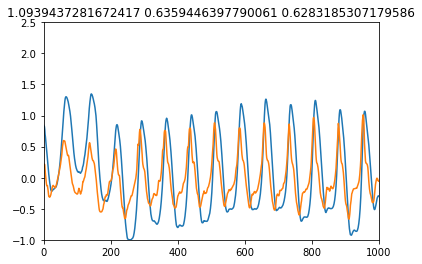

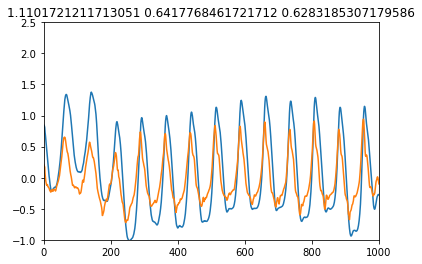

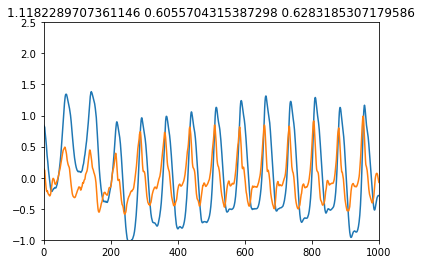

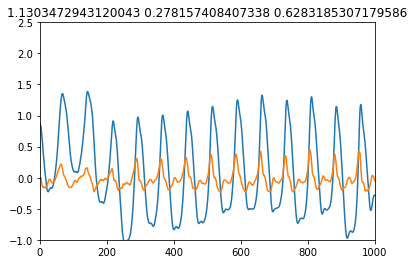

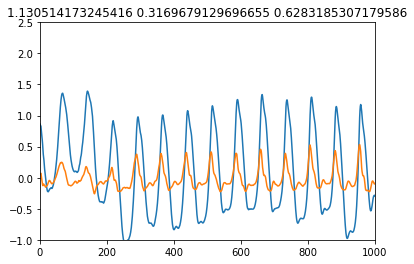

...

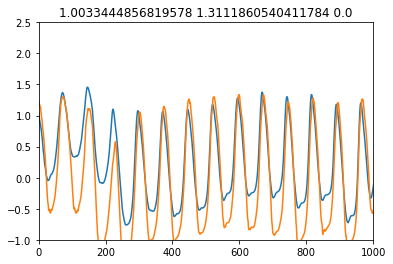

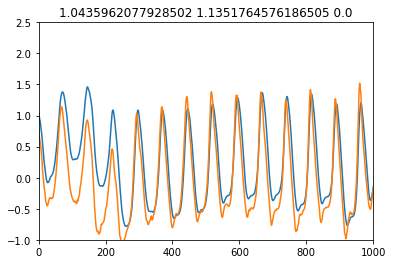

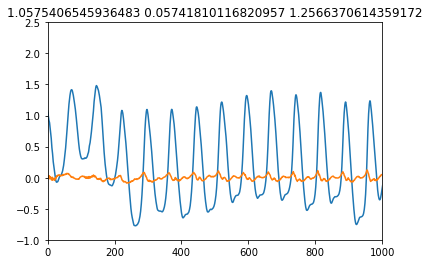

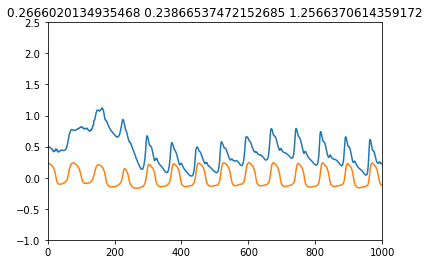

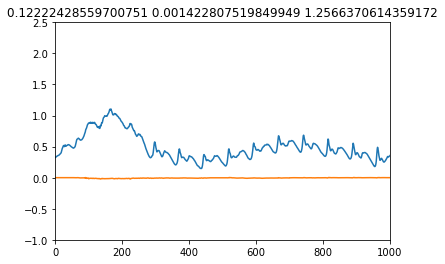

<ipython-input-10-5d7f78938692>:73: RuntimeWarning:

invalid value encountered in double_scalars



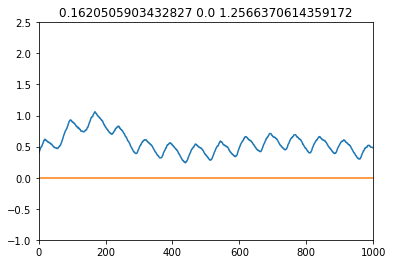

In [13]:
output = create_hydrodynamic_dataset(data,dataformat_data,dimformat_data,varformat_data,replacement_data,dataformat_replacement_data,dimformat_replacement_data,varformat_replacement_data,station_interpreter,selected_stations,missing_stations,replacement_nodes,replacement_nodes_use_current_velocity,True)
dataset = output

In [14]:
dataset

<xarray.Dataset>
Dimensions:                                  (TIME: 52561, STATION: 329,
                                              LAYER: 10, VERTTIDES: 2373,
                                              TIDEINFO: 2, HORTIDES: 2359,
                                              OBSHORTIDES: 2359)
Coordinates:
    Times                                    (TIME) datetime64[ns] 2019-01-01...
    Stations                                 (STATION) <U16 '8866969' ... 'He...
    Relative layer height                    (LAYER) float64 0.12 0.12 ... 0.06
Dimensions without coordinates: TIME, STATION, LAYER, VERTTIDES, TIDEINFO,
                                HORTIDES, OBSHORTIDES
Data variables:
    Water level                              (STATION, TIME) float64 0.8429 ....
    Layers                                   (STATION, LAYER, TIME) float64 -...
    Depth                                    (STATION) float64 25.54 ... 14.91
    Current velocity                         (STATION, LAYER, TIME) float64 0...
    Current direction                        (STATION, LAYER, TIME) float64 -...
    Astronomic water level                   (STATION, TIME) float64 0.8976 ....
    Vertical tidal periods                   (STATION, VERTTIDES, TIDEINFO) <U32 ...
    Horizontal tidal periods                 (STATION, HORTIDES, TIDEINFO) <U32 ...
    Observed horizontal tidal periods        (STATION, OBSHORTIDES, TIDEINFO) <U32 ...
    Phase lag                                (STATION) float64 38.66 ... 44.7
    Depth-averaged primary current velocity  (STATION, TIME) float64 0.181 .....

In [15]:
output = xr.open_dataset(r'C:\\Users\\floorbakker\\Desktop\\hydrodynamic_data_temp.nc')
dataset_loaded = xr.open_dataset(r'C:\\Users\\floorbakker\\Desktop\\hydrodynamic_data_final.nc')
station_data = np.array([  '8866969', '8866305', '8865822', '8864748', '8860701', '8861022',
                           '8863139', '8863914', '8864288', '8862714', '8862288', '8864805',
                           '8866260', '8867639', '8864185', '8863919', '8864615', '18008360',
                           '18008345', '18008346', '8864014', '8862102', '8867633', '8865973',
                           '8861242', '8867341', '8864722', '8861217', '19440561', '8868049',
                           '8863826', '22161426', '22161408', 'B45863_B', '8866170',
                           'B49209_A', 'B33440_B', '8863594', 'B15339_A', '8867024',
                           '8864161', '8864283', '8860614', 'B5729_A', '8867449', '8864085',
                           '8861610', '8862332', '8863941', '8864394', '8862930', '8866083',
                           '8863674', '8863525', '8860891', '8864952', '8863570', '8863776',
                           '8868450', '8866635', '8868177', '8862214', '8864217', '8860647',
                           '8867104', '8864002', '8865518', '8861067', '8866119', '8866780',
                           '8864266', '8862925', '8864465', '8864345', '8860845', 'S14716_A',
                           '8861674', '8861158', '8867547', '8867980', '8862973', '8860596',
                           '8864988', '8865217', '8863475', '8863090', '8864069', '8868083',
                           '8861732', '8860615', '8863253', '8868419', '8866999', '8868178',
                           '8866859', '8861716', '8862585', '8860947', '8867066', '8865803',
                           '8863200', 'S38127_B', '8867029', '8867154', '8863786', '8865027',
                           '8861414', '8868418', '8862143', '8867784', '8864737',
                           'S22992990_B', '8867023', '8863810', '8866899', '8867922',
                           '8867119', '8860547', '8861908', '8864195', '8863665', '8866472',
                           '8865003', '8861503', '8867482', '8865128', '8863166', '28197691',
                           '8867304', '8862678', '8864137', '8864595', '8866901', '8868151',
                           '8865998', '8865256', '8864551', '8864159', '8868460', '8867130',
                           '8862663', '8863040', '8864989', 'B19218_B', '8863623', '8863936',
                           '8867571', '8864376', '8864482', '8868239', '8867363', '8864753',
                           '8867982', '8865789', '8863206', '8861764', '8865820', '8863496',
                           '8863982', '8862087', '8862437', '8861736', '8862750', '8861165',
                           '8866182', '8861718', '8867813', '8866520', '8865942', '8864169',
                           '8864755', '8865151', '8862958', '8865951', '8866689', '8862757',
                           '8863191', '8868161', '8861780', '8867329', '8863988', '8862625',
                           '8864479', '8866961', '8861688', '8861986', '8861973', '8867672',
                           '8861290', '8861689', '8862404', '8862540', '8863756', '8861605',
                           '8865802', '8865086', '8860668', '8862134', '8862206', '8863963',
                           '8865146', '8867682', '8865205', '8865385', '8865575', '8866900',
                           '8860727', '8861552', '8861926', '8865972', '8860840', '8865558',
                           '8860853', '8861397', '8866130', '8865997', '8860787', '8865264',
                           '8861248', '8864192', '8860954', '8863903', '8864050', '8862868',
                           '8865818', '8865302', '8861378', '8867239', '8860697', '8861791',
                           '8861233', '8867012', '8866364', '8864525', '8867789', '8860903',
                           '8862531', 'Berth30', '8866388', '8861047', '8867851', '8863104',
                           '8867528', '8861169', 'B5979609_A', '8863618', '8863710',
                           '8867973', '8863275', '18008371', 'B17838816_B', 'B42792_B',
                           'Koningshaven', 'Maashaven', 'Waalhaven', 'Wiltonhaven',
                           'Vulcaanhaven', 'Zevenmanshaven', 'Botlekhaven',
                           '2ePetroleumhaven', '1ePetroleumhaven', 'Botlekbrug', 'Scheurkade',
                           'Centrale Geul', '8862490', '8864653', '8868071', '26519656',
                           '8860742', '8865570', '28197684', '8861583', '8862130', '28313843',
                           '8860725', '8862953', 'B57361_B', '8862132', '8863119', 'B29137_B',
                           '8862763', '8865127', '8861123', '8861547', '8861142', '8863829',
                           'L28489_A', '8867008', '8865732', '8867102', '8862463', '8862538',
                           '8863979', '8868176', '8867745', 'B44072_A', 'B5979609_B',
                           '8863678', '8864025', 'S14716_B', 'B14087_A', '8867387', '8867448',
                           '8864978', '8865784', 'B17838816_A', 'B15339_B', 'B45863_A',
                           '8866590', '8866992', 'B7951_A', '8867343', 'B5729_B', 'B57361_A',
                           'B42792_A', 'B44869_A', 'B15331_A', 'L28489_B', 'B33440_A',
                           'B49209_B', 'B44072_B', 'S38127_A', 'B57921_B', 'B7951_B',
                           '8866969B', '8866969A', '8866969C', 'Eemhaven', 'Heysehaven'])
station_data = xr.DataArray(data=station_data[0:267],dims='STATION')
output['Stations'] = station_data
#derive_specific_information(output)

In [16]:
output = output.drop('Stations')
output.to_netcdf(b'C:\\Users\\floorbakker\\Desktop\\hydrodynamic_data_temp.nc')

In [17]:
reindexing_list = []
station_list = list(FG.nodes)
station_list.extend(list_of_additional_stations)
for station in dataset['Stations'].values:
    reindexing_list.append(station_list.index(station))

In [18]:
dataset['Stations'].values = reindexing_list
dataset = dataset.sortby('Stations')

In [19]:
new_station_list = [station_list[station] for station in dataset['Stations'].values]

In [20]:
dataset = dataset.drop('Stations')
dataset.to_netcdf(b'C:\\Users\\floorbakker\\Desktop\\hydrodynamic_data_final4.nc')

<ipython-input-20-5c076403ec5c>:2: SerializationWarning:

coordinate 'Relative layer height' has a space in its name, which means it cannot be marked as a coordinate on disk and will be saved as a data variable instead



In [21]:
def observed_tidal_periods_station(dataset,times_horizontal_tidal_period):
    observed_times_horizontal_tidal_period = copy.deepcopy(times_horizontal_tidal_period)
    previous_index = 0
    for period in enumerate(observed_times_horizontal_tidal_period):
        if period[1][0] == len(dataset['Depth-averaged primary current velocity'].values):
            continue
        if period[1][1] == 'Flood Start':
            if dataset['Depth-averaged primary current velocity'].values[period[1][0]] > 0:
                previ = np.argmin(dataset['Depth-averaged primary current velocity'].values[previous_index:(period[1][0]+1)])+previous_index
                if previ == (period[1][0]+1): previ -= 1
                new_index = np.argmin(abs(dataset['Depth-averaged primary current velocity'].values[previ:(period[1][0]+1)]))+previ
                maxie = np.min(dataset['Depth-averaged primary current velocity'].values[previous_index:(period[1][0]+1)])    
            elif dataset['Depth-averaged primary current velocity'].values[period[1][0]] < 0:
                if period[0] != len(observed_times_horizontal_tidal_period)-1:
                    next_index = np.argmax(dataset['Depth-averaged primary current velocity'].values[period[1][0]:observed_times_horizontal_tidal_period[period[0]+1][0]])+period[1][0]
                    if next_index == period[1][0]: next_index += 1
                    new_index = np.argmin(abs(dataset['Depth-averaged primary current velocity'].values[period[1][0]:next_index]))+period[1][0]
                    maxie = np.max(dataset['Depth-averaged primary current velocity'].values[period[1][0]:observed_times_horizontal_tidal_period[period[0]+1][0]])
        elif period[1][1] == 'Ebb Start':
            if dataset['Depth-averaged primary current velocity'].values[period[1][0]] > 0:
                if period[0] != len(observed_times_horizontal_tidal_period)-1:
                    next_index = np.argmin(dataset['Depth-averaged primary current velocity'].values[period[1][0]:observed_times_horizontal_tidal_period[period[0]+1][0]])+period[1][0]
                    if next_index == period[1][0]: next_index += 1
                    new_index = np.argmin(abs(dataset['Depth-averaged primary current velocity'].values[period[1][0]:next_index]))+period[1][0]
                    maxie = np.min(dataset['Depth-averaged primary current velocity'].values[period[1][0]:observed_times_horizontal_tidal_period[period[0]+1][0]])
            elif dataset['Depth-averaged primary current velocity'].values[period[1][0]] < 0: 
                previ = np.argmax(dataset['Depth-averaged primary current velocity'].values[previous_index:(period[1][0]+1)])+previous_index
                if previ == (period[1][0]+1): previ -= 1
                new_index = np.argmin(abs(dataset['Depth-averaged primary current velocity'].values[previ:(period[1][0]+1)]))+previ
                maxie = np.max(dataset['Depth-averaged primary current velocity'].values[previous_index:(period[1][0]+1)])  
        previous_index = new_index
        observed_times_horizontal_tidal_period[period[0]][0] = new_index

    return observed_times_horizontal_tidal_period

def tidal_periods_station(dataset,time_zone):
    times_vertical_tidal_periods = []
    times_horizontal_tidal_periods = []
    phase_lags = []
    time_step = (dataset['Times'].values[1]-dataset['Times'].values[0])/np.timedelta64(1,'s')
    timestamps = [(value-np.datetime64('1970-01-01T00:00:00'))/np.timedelta64(1, 's') for value in dataset['Times'].values]
    
    astro_data_primary_current_velocity,_,comp_cur = astronomical_tide(dataset['Times'].values,dataset['Depth-averaged primary current velocity'].values,time_zone)
    astro_data_water_level_reduced,_,comp_wlev_red = astronomical_tide(dataset['Times'].values,dataset['Water level'].values,time_zone,reduced_selected_const)
    astro_data_primary_current_velocity_reduced,_,comp_cur_red = astronomical_tide(dataset['Times'].values,dataset['Depth-averaged primary current velocity'].values,time_zone,reduced_selected_const)   

    roots = sc.interpolate.CubicSpline(timestamps,astro_data_water_level_reduced[1]).roots()
    roots = [root for root in roots if root>=timestamps[0] and root<=timestamps[-1]]
    times_vertical_tidal_period = []
    for root in enumerate(roots):
        if root[0] == 0:
            start_time = root[0]
            continue
        start_time_index = bisect.bisect_right(timestamps,roots[root[0]-1])-1
        end_time_index = bisect.bisect_right(timestamps,root[1])-1
        if start_time_index == end_time_index:
            continue
        wlev_diff_cross = astro_data_water_level_reduced[1][end_time_index+1]-astro_data_water_level_reduced[1][end_time_index-1]
        if wlev_diff_cross >= 0:
            min_wlev = np.min(astro_data_water_level_reduced[1][start_time_index:end_time_index])
            times_vertical_tidal_period.append([astro_data_water_level_reduced[1].index(min_wlev),'Rising Start'])
        elif wlev_diff_cross <= 0:
            max_wlev = np.max(astro_data_water_level_reduced[1][start_time_index:end_time_index])
            times_vertical_tidal_period.append([astro_data_water_level_reduced[1].index(max_wlev),'Falling Start'])

    if times_vertical_tidal_period[0][1] == 'Falling Start': 
        times_vertical_tidal_period.insert(0,[0,'Rising Start'])
    elif times_vertical_tidal_period[0][1] == 'Rising Start': 
        times_vertical_tidal_period.insert(0,[0,'Falling Start'])                           
    times_vertical_tidal_periods.append(times_vertical_tidal_period)

    #Phase shift
    phase_lag = lag_finder(timestamps,astro_data_water_level_reduced[1],astro_data_primary_current_velocity_reduced[1])
    mean_tidal_period = (timestamps[-1]-timestamps[0])/(len(times_vertical_tidal_periods)/2)

    #Horizontal tidal period
    times_horizontal_tidal_period = []
    max_ampl_wlev = np.max(list(comp_wlev_red['A'][0:6]))+np.max(list(comp_wlev_red['A'][6:28]))+np.max(list(comp_wlev_red['A'][28:34]))+np.max(list(comp_wlev_red['A'][34:]))
    max_ampl_cur = np.max(list(comp_cur_red['A'][0:6]))+np.max(list(comp_cur_red['A'][6:28]))+np.max(list(comp_cur_red['A'][28:34]))+np.max(list(comp_cur_red['A'][34:]))
    print(max_ampl_wlev,max_ampl_cur)
    if max_ampl_wlev < 0.25 or max_ampl_cur < 0.25:
        for period in times_vertical_tidal_period:
            if period[1] == 'Falling Start':
                times_horizontal_tidal_period.append([period[0],'Ebb Start'])
            elif period[1] == 'Rising Start':
                times_horizontal_tidal_period.append([period[0],'Flood Start'])
        phase_lag = 0.25*mean_tidal_period
    else:
        astro_data_primary_current_velocity_reduced[1] = [value-comp_cur_red['A'][0] for value in astro_data_primary_current_velocity_reduced[1]]
        for iteration in range(2*int(abs(phase_lag/mean_tidal_period))+1):
            if round(phase_lag/mean_tidal_period,1)*2*np.pi < -0.5*np.pi:
                dataset['Depth-averaged primary current velocity'] = [-1*value for value in dataset['Depth-averaged primary current velocity'].values]
                if phase_lag > 0: phase_lag = 0.5*mean_tidal_period-phase_lag
                elif phase_lag < 0: phase_lag = 0.5*mean_tidal_period+phase_lag
            elif round(phase_lag/mean_tidal_period,1)*2*np.pi > 0.5*np.pi:
                phase_lag = phase_lag-mean_tidal_period
            elif round(phase_lag/mean_tidal_period,1)*2*np.pi < -np.pi:
                phase_lag = phase_lag+mean_tidal_period
            else:
                break

        if phase_lag < 0:
            phase_lag = 0

        # Interpolation of the variation of the water level and calculation of the zero crossing times
        intp = sc.interpolate.CubicSpline(astro_data_primary_current_velocity_reduced[0], astro_data_primary_current_velocity_reduced[1])
        index_prev_root = 0
        for root in intp.roots():
            index_current_root = bisect.bisect_right(astro_data_primary_current_velocity_reduced[0], root)-1
            if index_current_root == -1: index_current_root = index_current_root + 1
            if astro_data_primary_current_velocity_reduced[0][index_current_root]-root <= time_step: index_current_root = index_current_root + 1
            if len(astro_data_primary_current_velocity_reduced[1][index_prev_root:index_current_root]) == 0:
                continue
            if root >= timestamps[0] and root <= timestamps[-1] and np.max(astro_data_primary_current_velocity_reduced[1][index_prev_root:index_current_root]) > 0:
                times_horizontal_tidal_period.append([index_current_root, 'Ebb Start'])
                index_prev_root = index_current_root
            elif root >= timestamps[0] and root <= timestamps[-1] and np.min(astro_data_primary_current_velocity_reduced[1][index_prev_root:index_current_root]) < 0:
                times_horizontal_tidal_period.append([index_current_root, 'Flood Start'])
                index_prev_root = index_current_root
        observed_times_horizontal_tidal_period = observed_tidal_periods_station(dataset,times_horizontal_tidal_period) 
    
    tidal_period_data = [int(data[0]) for data in times_horizontal_tidal_period if data[0] != 'nan']
    obs_tidal_period_data = [int(data[0]) for data in observed_times_horizontal_tidal_period if data[0] != 'nan']
    plt.figure()
    plt.plot(astro_data_primary_current_velocity_reduced[0],intp(astro_data_primary_current_velocity_reduced[0]))
    plt.plot(timestamps,dataset['Depth-averaged primary current velocity'].values)
    plt.plot([timestamps[index] for index in tidal_period_data],[intp(astro_data_primary_current_velocity_reduced[0])[index] for index in tidal_period_data],'o')
    plt.plot([timestamps[index] for index in tidal_period_data],[dataset['Depth-averaged primary current velocity'].values[index] for index in tidal_period_data],'o')
    plt.plot([timestamps[index] for index in obs_tidal_period_data],[dataset['Depth-averaged primary current velocity'].values[index] for index in obs_tidal_period_data],'o')
    plt.xlim(timestamps[0],timestamps[1000])
    plt.show()
    print(intp.roots()[:-1])
    phase_lags.append(np.degrees(phase_lag/mean_tidal_period*2*np.pi))
    times_horizontal_tidal_periods.append(times_horizontal_tidal_period)
    
    plt.figure()
    plt.plot(intp(timestamps))
    plt.plot(obs_tidal_period_data,[dataset['Depth-averaged primary current velocity'].values[index] for index in obs_tidal_period_data],'o')
    plt.xlim([0,1000])
    plt.ylim([-1,2.5])
    plt.title(str(np.sum(comp_wlev_red['A']))+' '+str(np.sum(comp_cur_red['A'])))
    plt.show()
    return times_vertical_tidal_periods, times_horizontal_tidal_periods, phase_lags, comp_wlev_red,observed_times_horizontal_tidal_period

In [22]:
_,tidal_period_data,_,comps,observed_times_horizontal_tidal_period = tidal_periods_station(hydrodynamic_data.loc[dict(STATION=173)],'Europe/Amsterdam')

NameError: name 'hydrodynamic_data' is not defined

In [ ]:
station = 173
plt.plot(hydrodynamic_data['Depth-averaged primary current velocity'].values[station])
tidal_period_data = [int(data[0]) for data in tidal_period_data[0] if data[0] != 'nan']
obstidal_period_data = [int(data[0]) for data in hydrodynamic_data['Observed horizontal tidal periods'][station] if data[0] != 'nan']
plt.plot(tidal_period_data,[hydrodynamic_data['Depth-averaged primary current velocity'].values[station][index] for index in tidal_period_data],'ko')
plt.plot(obstidal_period_data,[hydrodynamic_data['Depth-averaged primary current velocity'].values[station][index] for index in tidal_period_data],'bo')
plt.xlim([0,1000])
plt.ylim([-1,2.5])

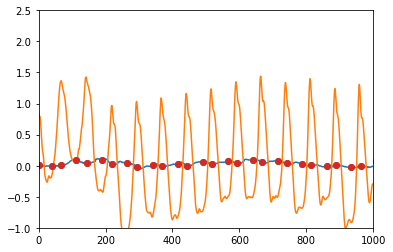

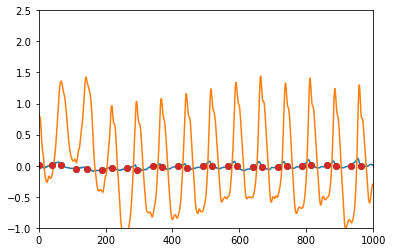

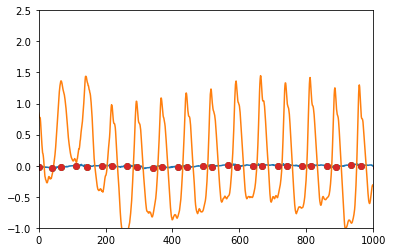

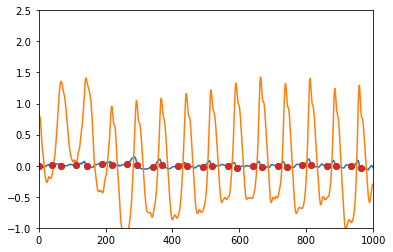

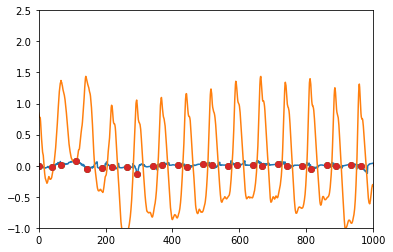

...

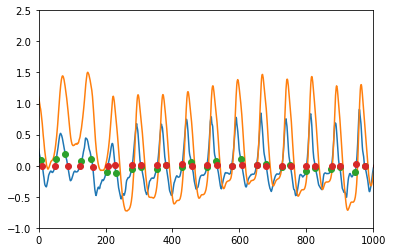

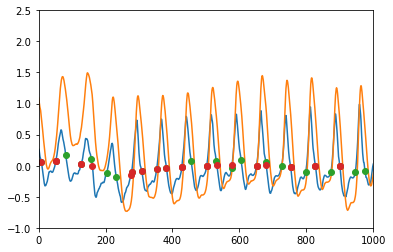

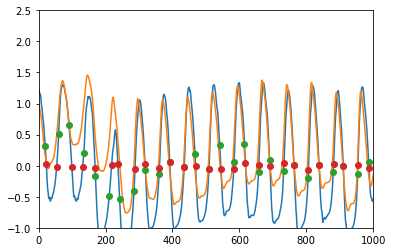

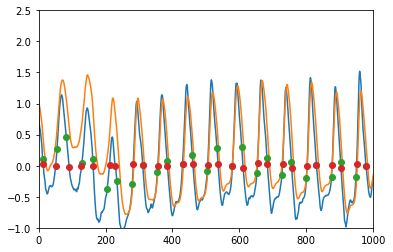

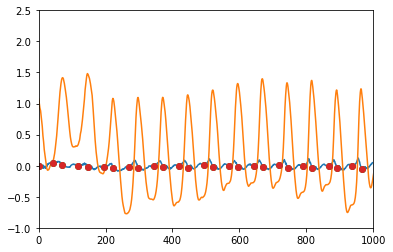

In [25]:
for station in enumerate(hydrodynamic_data['Stations'].values):
    plt.figure()
    plt.plot(hydrodynamic_data['Depth-averaged primary current velocity'].values[station[0]])
    plt.plot(hydrodynamic_data['Water level'].values[station[0]])
    tidal_period_data = [int(data[0]) for data in hydrodynamic_data['Horizontal tidal periods'][station[0]] if data[0] != 'nan']
    obstidal_period_data = [int(data[0]) for data in hydrodynamic_data['Observed horizontal tidal periods'][station[0]] if data[0] != 'nan']
    plt.plot([index for index in tidal_period_data if index < len(hydrodynamic_data['Depth-averaged primary current velocity'].values[station[0]])-1],[hydrodynamic_data['Depth-averaged primary current velocity'].values[station[0]][index] for index in tidal_period_data if index < len(hydrodynamic_data['Depth-averaged primary current velocity'].values[station[0]])-1],'o')
    plt.plot([index for index in obstidal_period_data if index < len(hydrodynamic_data['Depth-averaged primary current velocity'].values[station[0]])-1],[hydrodynamic_data['Depth-averaged primary current velocity'].values[station[0]][index] for index in obstidal_period_data if index < len(hydrodynamic_data['Depth-averaged primary current velocity'].values[station[0]])-1],'o')
    plt.xlim([0,1000])
    plt.ylim([-1,2.5])
    plt.show()

In [ ]:
hydrodynamic_data['Horizontal tidal periods'][station]

In [ ]:
hydrodynamic_data['Observed horizontal tidal periods'][173]

In [ ]:
dataset['Depth-averaged primary current velocity']

In [23]:
dataset_loaded = xr.open_dataset(r'C:\\Users\\floorbakker\\Desktop\\hydrodynamic_data_final4.nc')
stations_loaded_dataset = list(FG.nodes)
stations_loaded_dataset.extend(list_of_additional_stations)
station_data = xr.DataArray(data=stations_loaded_dataset,dims='STATION')
dataset_loaded['Stations'] = station_data
dataset_loaded

<xarray.Dataset>
Dimensions:                                  (TIME: 52561, STATION: 329,
                                              VERTTIDES: 2373, TIDEINFO: 2,
                                              HORTIDES: 2359,
                                              OBSHORTIDES: 2359, LAYER: 10)
Coordinates:
    Times                                    (TIME) datetime64[ns] ...
Dimensions without coordinates: TIME, STATION, VERTTIDES, TIDEINFO, HORTIDES,
                                OBSHORTIDES, LAYER
Data variables: (12/13)
    Water level                              (STATION, TIME) float32 ...
    Astronomic water level                   (STATION, TIME) float64 ...
    Depth-averaged primary current velocity  (STATION, TIME) float64 ...
    Vertical tidal periods                   (STATION, VERTTIDES, TIDEINFO) object ...
    Horizontal tidal periods                 (STATION, HORTIDES, TIDEINFO) object ...
    Observed horizontal tidal periods        (STATION, OBSHORTIDES, TIDEINFO) object ...
    ...                                       ...
    Current velocity                         (STATION, LAYER, TIME) float64 ...
    Current direction                        (STATION, LAYER, TIME) float64 ...
    Depth                                    (STATION) float64 ...
    Phase lag                                (STATION) float64 ...
    Relative layer height                    (LAYER) float64 ...
    Stations                                 (STATION) <U16 '18008345' ... 'C...

In [24]:
hydrodynamic_data = dataset_loaded

In [ ]:
m = folium.Map(location=[51.85, 4.4], zoom_start = 10, tiles="cartodbpositron")
colormap = cm.get_cmap('Blues', 256)
norm = mpl.colors.Normalize(vmin=0,vmax=90)
param = 'Phase lag'
t = 0

for node in enumerate(FG.nodes(data = True)):
    points_x = list(node[1][1]["geometry"].coords.xy[0])
    points_y = list(node[1][1]["geometry"].coords.xy[1])
    
    point = []
    for i, _ in enumerate(points_x):
        point.append((points_y[i], points_x[i]))
    else:
        folium.Circle(point[0], radius=12,fill=True, color = color_sampler(hydrodynamic_data[param][node[0]],colormap,norm), fill_opacity=1,tooltip = hydrodynamic_data[param][node[0]].values,popup =node[1][0]).add_to(m)

for edge in FG.edges(data = True):
    points_x = list(edge[2]["Info"]["geometry"].coords.xy[0])
    points_y = list(edge[2]["Info"]["geometry"].coords.xy[1])
    index = list(FG.nodes).index(edge[0])
    
    line = []
    for i, _ in enumerate(points_x):
        line.append((points_y[i], points_x[i]))
    
    else:
        popup = folium.Popup(width=500, height=300)
        folium.PolyLine(line, weight = 3, color=color_sampler(hydrodynamic_data[param][index],colormap,norm), tooltip = hydrodynamic_data[param][index].values, popup = [edge[0],edge[1]]).add_to(m)

m

In [ ]:
#for station in range(len(hydrodynamic_data['Stations'])):
station = 173
fig,[ax1,ax2] = plt.subplots(1,2,figsize=[16,2])
ax1.plot(hydrodynamic_data['Water level'][station].values)
tidal_period_data = [int(data[0]) for data in hydrodynamic_data['Vertical tidal periods'][station].values if data[0] != 'nan']
ax1.plot(tidal_period_data,np.zeros(len(tidal_period_data)),'ko')
ax1.set_xlim([0,1000])
ax1.set_title(str(station))
ax2.plot(hydrodynamic_data['Depth-averaged primary current velocity'][station].values)
tidal_period_data = [int(data[0]) for data in hydrodynamic_data['Horizontal tidal periods'][station].values if data[0] != 'nan']
ax2.plot(tidal_period_data,[hydrodynamic_data['Depth-averaged primary current velocity'][station].values[index] for index in tidal_period_data],'ko')
ax2.set_xlim([0,1000])
ax2.set_title(str(station))
plt.show();

In [ ]:
hydrodynamic_data['Phase lag'][list(hydrodynamic_data['Stations'].values).index('8863810')]

In [ ]:
# def create_geojson_features(edge):
#     features = []
#     index = list(FG.nodes).index(edge[0])
    
#     for time in enumerate(time_data_stations):
#         if time[0] < len(time_data_stations)-1:
#             feature = {'type': 'Feature',
#                        'geometry': {'type':'Point', 
#                                            'coordinates':[[FG.edges[edge]['Info']['geometry'].xy[0][0],FG.edges[edge]['Info']['geometry'].xy[1][0]],
#                                                           [FG.edges[edge]['Info']['geometry'].xy[0][1],FG.edges[edge]['Info']['geometry'].xy[1][1]],]},
#                        'properties': {'times': [datetime.fromtimestamp(time[1]).strftime('%Y-%m-%dT%H:%M:%S'),
#                                                datetime.fromtimestamp(time_data_stations[time[0]+1]).strftime('%Y-%m-%dT%H:%M:%S')],
#                                       'style': {'color' : color_sampler(hydrodynamic_data['Water level'][index][time[0]],colormap,norm)},
#                                       'icon': 'circle',
#                                       'iconstyle':{'fillColor': "red",
#                                                    'fillOpacity': 0.8,
#                                                    'stroke': 'true',
#                                                    'radius': 7}}}
#             features.append(feature)
#     return features

In [ ]:
# def make_map(features):
#     map = folium.Map(location=[51.85, 4.4], zoom_start = 10, tiles="cartodbpositron")

#     TimestampedGeoJson(
#         {'type': 'FeatureCollection',
#          'features': features}
#         , period='P1M'
#         , add_last_point=True).add_to(map)
#     return map

In [ ]:
# all_features_edges = []
# for edge in enumerate(FG.edges):
#     features_edge = create_geojson_features(edge[1])
#     all_features_edges.extend(features_edge)
#     if edge[0] == 2:
#         break

In [ ]:
# make_map(all_features_edges)

In [ ]:
m = folium.Map(location=[51.85, 4.4], zoom_start = 10, tiles="cartodbpositron")
colormap = cm.get_cmap('jet', 256)
norm = mpl.colors.Normalize(vmin=0,vmax=90)
t = 0

for node in enumerate(FG.nodes(data = True)):
    points_x = list(node[1][1]["geometry"].coords.xy[0])
    points_y = list(node[1][1]["geometry"].coords.xy[1])
    
    point = []
    for i, _ in enumerate(points_x):
        point.append((points_y[i], points_x[i]))
    else:
        folium.Circle(point[0], radius=12,fill=True, color = color_sampler(delays_data[node[0]][0],colormap,norm), fill_opacity=1,tooltip = delays_data[node[0]][0],popup =node[1][0]).add_to(m)

for edge in FG.edges(data = True):
    points_x = list(edge[2]["Info"]["geometry"].coords.xy[0])
    points_y = list(edge[2]["Info"]["geometry"].coords.xy[1])
    index = list(FG.nodes).index(edge[0])
    
    line = []
    for i, _ in enumerate(points_x):
        line.append((points_y[i], points_x[i]))
    
    else:
        popup = folium.Popup(width=500, height=300)
        folium.PolyLine(line, weight = 3, color=color_sampler(delays_data[index][0],colormap,norm), tooltip = delays_data[index][0], popup = [edge[0],edge[1]]).add_to(m)

m

In [ ]:
restriction_specifications = dict{} #for what vessels does the restriction hold?
restriction_type = dict{} #how does the restriction look like?

def normative_current_velocity(vessel_specifications,hydrodynamic_data, restriction):
    for restriction_class in enumerate(specifications[0]):
        # - if restriction does not apply to vessel because it is for vessels sailing in the opposite direction: continue loop
        if vessel.bound != specifications[2][restriction_class[0]]:
            continue
        if specifications[5][restriction_class[0]] != [] and (specifications[5][restriction_class[0]][0] not in route or specifications[5][restriction_class[0]][1] not in route):
            continue
        # - else: looping over the restriction criteria
        for restriction_type in enumerate(restriction_class[1]):
            # - if previous condition is not met and there are no more restriction criteria and the previous condition has an 'AND' boolean statement: continue loop
            if not boolean and restriction_type[0] == len(restriction_class[1]) - 1 and specifications[-1][restriction_class[0]][restriction_type[0] - 1] == 'and':
                continue
            # - if previous condition is not met and there are more restriction criteria and the next condition has an 'AND' boolean statement: continue loop
            if not boolean and restriction_type[0] != len(restriction_class[1]) - 1 and specifications[-1][restriction_class[0]][restriction_type[0]] == 'and':
                continue
            # - if previous condition is not met and the next condition has an 'OR' boolean statement: continue loop with predefined boolean
            if not boolean and restriction_type[0] != len(restriction_class[1]) - 1 and specifications[-1][restriction_class[0]][restriction_type[0]] == 'or':
                boolean = True
                continue

            # Extracting the correct vessel property for the restriction type
            if restriction_type[1].find('Length') != -1: value = getattr(vessel, 'L')
            if restriction_type[1].find('Draught') != -1: value = getattr(vessel, 'T_f')
            if restriction_type[1].find('Beam') != -1: value = getattr(vessel, 'B')
            if restriction_type[1].find('UKC') != -1: value = VesselTrafficService.provide_ukc_clearance(vessel,node,sailing_time_to_next_node,components_calc = True)
            if restriction_type[1].find('Type') != -1: value = getattr(vessel, 'type')
            # Determine if the value for the property satisfies the condition of the restriction type
            df = pd.DataFrame({'Value': [value],'Restriction': [specifications[1][restriction_class[0]][restriction_type[0]]]})
            boolean = df.eval('Value' + specifications[3][restriction_class[0]][restriction_type[0]] + 'Restriction')[0]

            # - if condition is not met: continue loop
            if not boolean and restriction_type[0] != len(restriction_class[1]) - 1:
                continue

            # - if one of the conditions is met and the restriction contains an 'OR' boolean statement:
            if boolean and restriction_type[0] != len(restriction_class[1]) - 1 and specifications[-1][restriction_class[0]][restriction_type[0]] == 'or':
                no_tidal_window = False
                break
            # - elif all the conditions are met and the restriction contains solely 'AND' boolean statements:
            elif boolean and restriction_type[0] == len(restriction_class[1]) - 1:
                no_tidal_window = False
                break

        # - if condition is met: break the loop
        if boolean == True:
            break

        else:
        boolean = True
    
    return restriction_class[0], no_tidal_window

In [ ]:
#0-5m
#0-15m
#dieptegemiddeld

In [ ]:
value = 5
station = 173
time = 0
layers = hydrodynamic_data['Layers'].transpose('STATION','TIME','LAYER')
velocities = hydrodynamic_data['Current velocity'].transpose('STATION','TIME','LAYER')
layers = layers[station].values[time]
velocities = velocities[station].values[time]
water_depth = hydrodynamic_data['Water level'][station].values[time] + hydrodynamic_data['Depth'][station].values
relative_layer_heigths = hydrodynamic_data['Relative layer height']

intp = sc.interpolate.interp1d(layers,velocities)
for layer in enumerate(layers):
    if layer[1] < -value:
        index = layer[0]
        break

mid_depth = np.mean([layer[1],layers[index-1]])
layer_depth = layers[index-1]+value
velocity_mid_depth = intp(mid_depth).sum()
layer_depths = [water_depth*layer for layer in relative_layer_heigths[0:index].values]
layer_depths.extend([layer_depth])
mid_current_velocities = list(velocities[0:index])
mid_current_velocities.extend([velocity_mid_depth])
average_velocity = np.average(mid_current_velocities,weights=layer_depths)
average_velocity